In [1]:
import os
import sys
import time
import numpy as np
import pandas as pd
import gzip
import matplotlib.pyplot as plt
import umap
import glob
import PyPDF2 
from natsort import natsorted 
import pickle


import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.font_manager as font_manager
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import random
import math

from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import mutual_info_score
from scipy.stats import pearsonr
from matplotlib.colors import Normalize
from matplotlib import cm

/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/umap/d

In [2]:
import matplotlib as mpl
from scipy.cluster import hierarchy
from scipy.spatial import distance
from matplotlib.colors import ListedColormap

In [3]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import MiniBatchKMeans
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN

from sklearn.metrics import precision_score, recall_score, f1_score
import pickle

In [4]:
sys.path.append('/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary')
import OONMF
import OONMFhelpers
from OONMFhelpers import get_barsortorder

In [5]:
os.chdir("/net/seq/data2/projects/aabisheva/Encode/my_ipynb/")
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_style("white")

from matplotlib.cm import get_cmap
cmap = get_cmap('tab10')

/tmp/ipykernel_39658/3438821175.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('tab10')


In [6]:
def make_continuous_stacked_bar_plot_sorted(self, Nrelevant, BarMatrix, bargraph_out, names=[], barsortorder=[], plot_title='', figdim1=150, figdim2=40):
    if len(barsortorder) < 1:
        barsortorder = np.arange(Nrelevant)

    if len(names) < 1:
        names = [str(i) for i in range(Nrelevant)]
        names = np.array(names)

    start = 0
    end = Nrelevant
    Xpositions = np.linspace(0, Nrelevant, Nrelevant, endpoint=False)

    self.define_colors()

    plt.clf()
    plt.figure(figsize=(figdim1, figdim2))

    for column in range(Nrelevant):
        ground_pSample = 0
        bar_heights = BarMatrix[:, start:end].T[barsortorder][column]
        indices = np.flip(np.argsort(bar_heights))
        sorted_heights = bar_heights[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.fill_between([Xpositions[column], Xpositions[column] + 1], ground_pSample, ground_pSample + sorted_heights[component], color=colours[component])
            ground_pSample = ground_pSample + sorted_heights[component]

    OONMFhelpers.increase_axis_fontsize()

    plt.ylabel('sum of signal in matrix', fontsize=70)
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / Nrelevant)**0.5 * 130
    thebottom = min([(1 / Nrelevant)**0.3 * 1.2, 0.3])

    plt.xticks(np.arange(0, Nrelevant, step=max(1, Nrelevant//10)), rotation='vertical', fontsize=samplenamesize)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=thebottom)
    plt.savefig(bargraph_out)
    #plt.show()
    plt.close()

OONMF.NMFobject.make_continuous_stacked_bar_plot_sorted = make_continuous_stacked_bar_plot_sorted


In [7]:
def make_stacked_bar_plot_sorted_horisontal(self, Nrelevant, BarMatrix, bargraph_out, names=[], barsortorder=[], plot_title='', figdim1=150, figdim2=40):
    if len(barsortorder) < 1:
        barsortorder = np.arange(Nrelevant)

    if len(names) < 1:
        names = [str(i) for i in range(Nrelevant)]
        names = np.array(names)

    start = 0
    end = Nrelevant
    Ypositions = np.arange(Nrelevant)

    self.define_colors()

    plt.clf()
    plt.figure(figsize=(figdim2, figdim1))  # switched figdim1 and figdim2

    for row in range(Nrelevant):
        ground_pSample = 0
        bar_widths = BarMatrix[:, start:end].T[barsortorder][row]
        indices = np.flip(np.argsort(bar_widths))
        # indices = np.arange(self.Ncomps)
        sorted_widths = bar_widths[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.barh(Ypositions[row], sorted_widths[component], left=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(sorted_widths[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.xlabel('sum of signal in matrix', fontsize=70)  # changed ylabel to xlabel
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / Nrelevant)**0.5 * 130
    thebottom = min([(1 / Nrelevant)**0.3 * 1.2, 0.3])

    plt.yticks(Ypositions, names[barsortorder], fontsize=samplenamesize)  # changed xticks to yticks
    plt.subplots_adjust(left=thebottom, right=0.9, top=0.9, bottom=0.1)  # adjusted the left parameter

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_stacked_bar_plot_sorted_horisontal = make_stacked_bar_plot_sorted_horisontal

In [8]:
def barsortorder_all_components(BarMatrix):
    bar_indices = np.empty(BarMatrix.T.shape)
    for i, bar in enumerate(BarMatrix):
        np.copyto(bar_indices[:, i], np.flip(np.argsort(bar)))
    return np.lexsort(np.flip(bar_indices, 0))

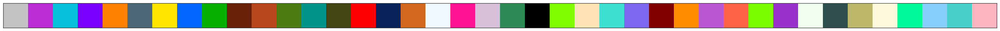

In [9]:
# Just color scheme inicialization

n_components = 40

colors_order = ['#FFE500', '#FE8102', '#FF0000', '#07AF00', '#4C7D14', '#414613', '#05C1D9', '#0467FD', '#009588', '#BB2DD4', '#7A00FF', '#4A6876', '#08245B', '#B9461D', '#692108', '#C3C3C3']
neworder = np.array([16,10,7,11,2,12,1,8,4,15,14,5,9,6,3,13]).astype(int) - 1
colors_order = list(np.array(colors_order)[neworder])

# THEN HERE IS A LOT WEIRD CODE TO SELECT COLORS
additional_indices = [19, 25, 26, 30, 39]

# Get colors for those indices from the existing random selection
colornames = np.sort(list(mcolors.CSS4_COLORS.keys()))
np.random.seed(10)
for _ in range(23):  
    newcolor = colornames[np.random.randint(len(colornames))]
    trialcount = 0
    while ((newcolor in colors_order) and (trialcount < 100)):
        newcolor = colornames[np.random.randint(0, len(colornames))]
        trialcount += 1
    colors_order.append(newcolor)

# Keep the colors you want
modified_colors = colors_order[:16]
for idx in additional_indices:
    modified_colors.append(colors_order[idx - 1])
modified_colors.extend(["black", "chartreuse", "moccasin"])

# Add random colors until the list has 40 colors
num_colors_to_add = n_components - len(modified_colors)
for _ in range(num_colors_to_add):
    newcolor = colornames[np.random.randint(len(colornames))]
    trialcount = 0
    while ((newcolor in modified_colors) and (trialcount < 100)):
        newcolor = colornames[np.random.randint(0, len(colornames))]
        trialcount += 1
    modified_colors.append(newcolor)
colors_order = modified_colors
    
# just for checking colors
fig, ax = plt.subplots(figsize=(len(modified_colors), 1))
# Draw a rectangle for each color in the list
for i, color in enumerate(modified_colors):
    rect = plt.Rectangle((i, 0), 1, 1, facecolor=color, edgecolor='none')
    ax.add_patch(rect)
ax.set_xlim(0, len(modified_colors))
ax.set_ylim(0, 1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect('equal')

plt.show()

In [10]:
def get_bar_indices_by_leading_components(BarMatrix, component1, component2):
    if component1 == component2:
        raise ValueError("Components cannot have the same value!")
    fitting_indices = []
    for i, bar in enumerate(BarMatrix):
        if np.flip(np.argsort(bar)).tolist()[:2] == [component1, component2]:
            fitting_indices.append(i)
    return fitting_indices

In [11]:
def make_stacked_bar_plot_two_components(self, BarMatrix, comp_indices, bargraph_out, names=[], plot_title='', figdim1=150, figdim2=40):
    if len(names) < 1:
        names = [str(i) for i in range(BarMatrix.shape[0])]
        names = np.array(names)

    plt.clf()
    plt.figure(figsize=(figdim2, figdim1))  # switched figdim1 and figdim2

    relevant_bars = BarMatrix[comp_indices, :]
    Ypositions = np.arange(relevant_bars.shape[0])

    for i, row in enumerate(relevant_bars):
        ground_pSample = 0
        indices = np.flip(np.argsort(row))
        sorted_widths = row[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.barh(Ypositions[i], sorted_widths[component], left=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(sorted_widths[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.xlabel('sum of signal in matrix', fontsize=70)  # changed ylabel to xlabel
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / relevant_bars.shape[0])**0.5 * 200
    thebottom = min([(1 / relevant_bars.shape[0])**0.3 * 1.2, 0.3])

    plt.yticks(Ypositions, names[comp_indices], fontsize=samplenamesize)  # changed xticks to yticks
    plt.subplots_adjust(left=thebottom, right=0.9, top=0.9, bottom=0.1)  # adjusted the left parameter

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_stacked_bar_plot_two_components = make_stacked_bar_plot_two_components

In [12]:
# the new one

def make_stacked_bar_plot_two_components(self, BarMatrix, comp_indices, bargraph_out, names=[], plot_title='', figdim1=150, figdim2=40, *, grouped_by_components=False):
    if len(names) < 1:
        names = [str(i) for i in range(BarMatrix.shape[0])]
        names = np.array(names)

    plt.clf()
    plt.figure(figsize=(figdim2, figdim1))

    relevant_bars = BarMatrix[comp_indices, :]
    Ypositions = np.arange(relevant_bars.shape[0])

    # Sort the components inside every bar
    sorted_bars = np.empty(relevant_bars.shape)
    sorted_colors = []
    sorting_indices = np.empty(relevant_bars.shape, dtype=np.int_)
    for i, bar in enumerate(relevant_bars):
        indices = np.flip(np.argsort(bar))
        sorted_widths = bar[indices]
        sorted_bars[i] = sorted_widths
        sorting_indices[i] = indices
        sorted_colors.append([self.Comp_colors[j] for j in indices])

    sorted_order = np.lexsort(np.flip(sorted_bars, axis=1).T)

    # Can't use numpy indices for lists, so have to sort manually
    sorted_colors_sorted = []
    for i in sorted_order:
        sorted_colors_sorted.append(sorted_colors[i])
    sorted_colors = sorted_colors_sorted

    sorted_bars = sorted_bars[sorted_order]
    sorting_indices = sorting_indices[sorted_order]

    if grouped_by_components:
        grouped_order = np.lexsort(np.flip(sorting_indices[:, :4], axis=1).T)

        sorted_bars = sorted_bars[grouped_order]
        sorting_indices = sorting_indices[grouped_order]
        sorted_colors_sorted = []
        for i in grouped_order:
            sorted_colors_sorted.append(sorted_colors[i])
        sorted_colors = sorted_colors_sorted

    for i, row in enumerate(sorted_bars):
        ground_pSample = 0
        colours = sorted_colors[i]

        for component in range(self.Ncomps):
            plt.barh(Ypositions[i], row[component], left=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(row[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.xlabel('sum of signal in matrix', fontsize=70)  # changed ylabel to xlabel
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / relevant_bars.shape[0])**0.5 * 200
    thebottom = min([(1 / relevant_bars.shape[0])**0.3 * 1.2, 0.3])

    names = names[comp_indices][sorted_order]
    if grouped_by_components:
        names = names[grouped_order]
    plt.yticks(Ypositions, names, fontsize=samplenamesize)  # changed xticks to yticks
    plt.subplots_adjust(left=thebottom, right=0.9, top=0.9, bottom=0.1)  # adjusted the left parameter

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_stacked_bar_plot_two_components = make_stacked_bar_plot_two_components

# Metadata

In [13]:
with open('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/indivs_order.txt', 'r') as f:
    sample_names = f.read().strip().split('\t')

# Read the metadata table
metadata_file = '/net/seq/data2/projects/ENCODE4Plus/indexes/index_altius_23-05-11/metadata/ENCODE4plus_master_metadata_for_analysis.tsv'
metadata = pd.read_csv(metadata_file, sep='\t')

# Set 'id' as the index
metadata.set_index('id', inplace=True)

# Filter and reorder the rows based on sample names
metadata = metadata.loc[sample_names]

# Reset the index
metadata.reset_index(inplace=True)

allnames = metadata['taxonomy_name'].to_list()

metadata

,id,tc_number,ds_number,ln_number,passed_agg_qc,hotspot1_spot,hotspot2_spot,nuclear_percent_duplication,taxonomy_name,ontology_id,...,nf_subsampled_spot1,dedupped_subsampled_spot1,dupRate_5M,library_kit,ln,nuclear_aligned,total_aligned,alignment_quality,dhsCounts_AllSamplesIndex,read_depth
0,AG80796,6419,DS12393,LN2503,YES,0.5689,0.4299,21.6078,CMK,EFO:0003037,...,0.5387,0.4431,0.078924,PE,LN2503,32730192.0,60738773.0,0.538868,68501.0,32693071.0
1,AG72371,21827,DS100247,LN82384A,YES,0.5158,0.4065,23.4548,h.HCT116.CDK7,EFO:0002824,...,0.5055,0.4884,0.028639,ThruPLEX DNA-seq Kit,LN82384A,97125448.0,130506912.0,0.744217,65376.0,97056200.0
2,AG81543,1057,DS38746,LN32943A,YES,0.3107,0.2338,5.1937,h.KASUMI-1,EFO:0006607,...,0.3110,0.3027,0.009148,SSlib-JV7Q,LN32943A,70296634.0,127108972.0,0.553042,91619.0,70230350.0
3,AG81555,1054,DS38656,LN32851A,NO,0.2935,0.2035,14.7722,h.KASUMI-1,EFO:0006607,...,0.2939,0.2759,0.030704,SSlib-JV7Q,LN32851A,55472874.0,91384032.0,0.607030,71619.0,55425579.0
4,AG80699,6975,DS14323,LN3036,YES,0.6416,0.4020,18.2760,h.WI-38,EFO:0001260,...,0.6004,0.5361,0.067307,PE,LN3036,24984098.0,34253236.0,0.729394,60925.0,24965490.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3775,AG6933,7523,DS39312,LN42983C,NO,0.2594,0.1888,12.8734,h.smooth muscle cell,CL:0000192,...,0.2588,0.2524,0.005988,Thruplex DNA-Seq H,LN42983C,242141104.0,293510790.0,0.824982,134383.0,210615155.0
3776,AG80385,6198,DS20493,LN4859,YES,0.6654,0.7099,24.2645,M059J,EFO:0005697,...,0.6664,0.5916,0.033388,TS,LN4859,363395028.0,493931604.0,0.735719,286727.0,362549906.0
3777,AG80384,6198,DS20497,LN4860,YES,0.6946,0.5915,27.2915,M059J,EFO:0005697,...,0.6561,0.5622,0.064872,TS,LN4860,50070307.0,63571471.0,0.787622,122558.0,45398379.0
3778,AG72440,11355,DS76812,LN60001A,YES,0.3483,0.1815,7.8514,h.PGP1.iPSC,EFO:0007950,...,0.3365,0.3320,0.004798,ThruPLEX DNA-seq Kit,LN60001A,165515930.0,194223517.0,0.852193,89072.0,164051090.0


In [14]:
dir_path_pipeline = "/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/"
dir_path_figures = "/net/seq/data2/projects/aabisheva/Encode/nextflow_results/figures/"
data_slice_size = "full"

# a bit about samples

METHOD:  unweight  N_components:  8
(3780, 8) (8, 4230461) matrixes loaded for n_components 8


<Figure size 640x480 with 0 Axes>

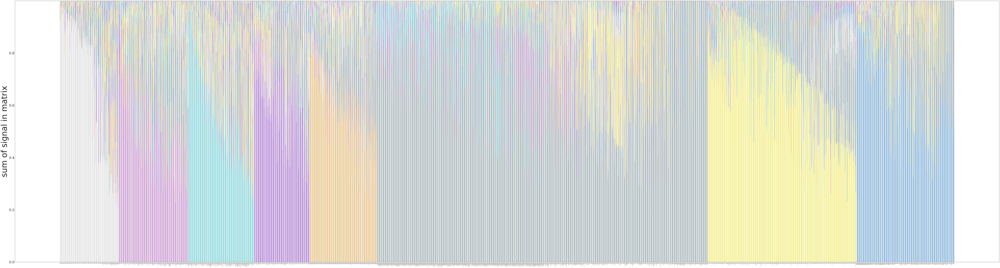

<Figure size 640x480 with 0 Axes>

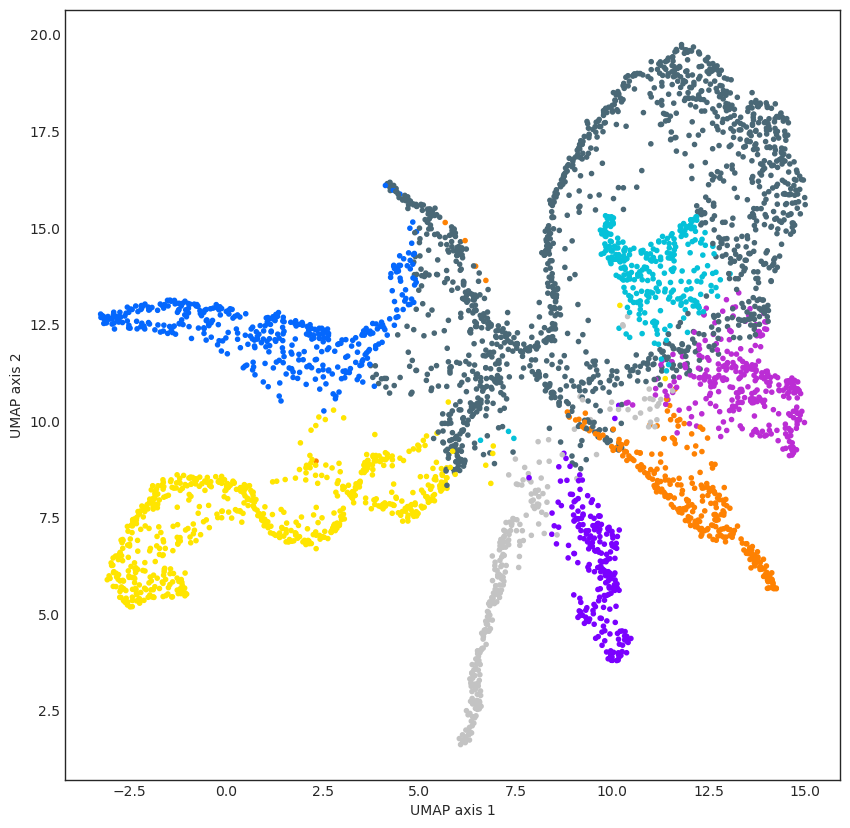

METHOD:  unweight  N_components:  16
(3780, 16) (16, 4230461) matrixes loaded for n_components 16


<Figure size 640x480 with 0 Axes>

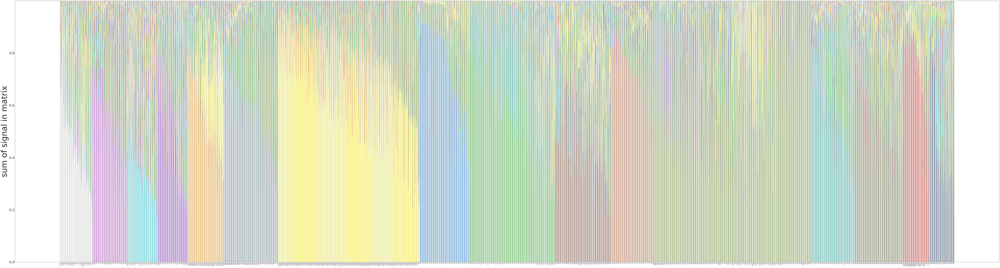

<Figure size 640x480 with 0 Axes>

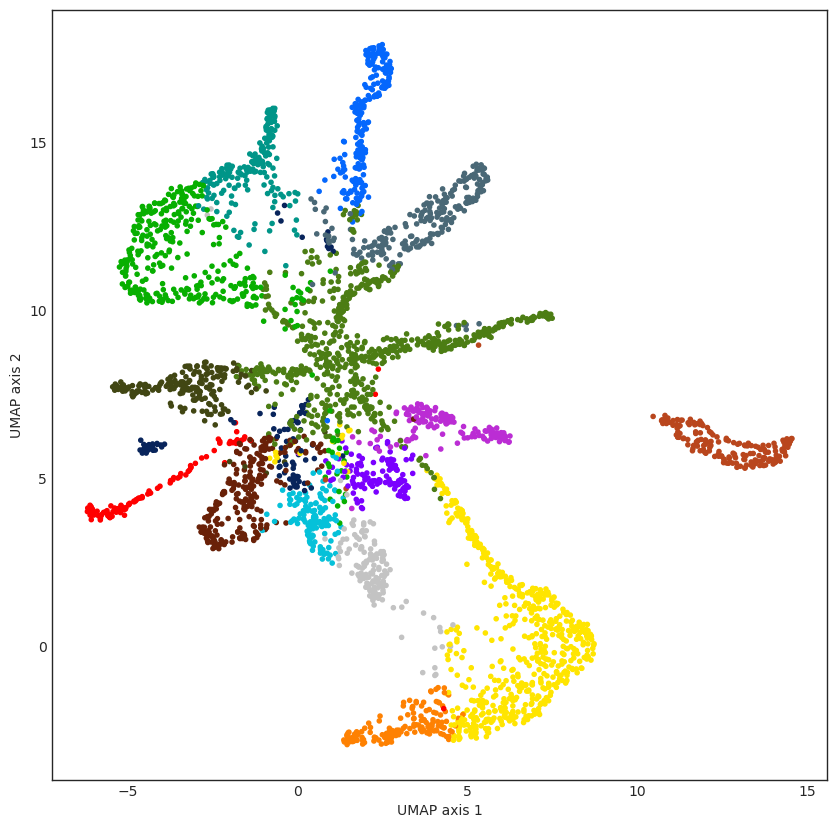

METHOD:  unweight  N_components:  24
(3780, 24) (24, 4230461) matrixes loaded for n_components 24


<Figure size 640x480 with 0 Axes>

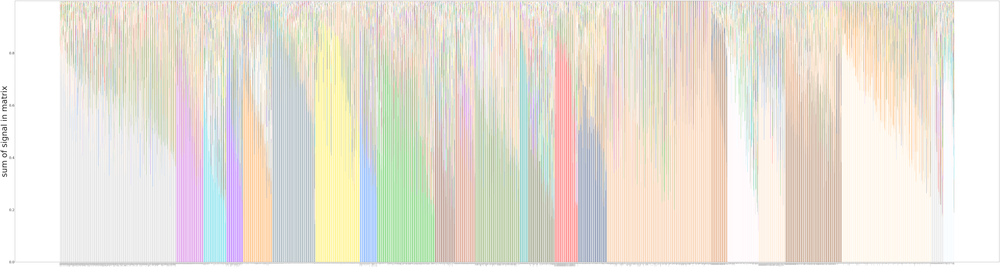

<Figure size 640x480 with 0 Axes>

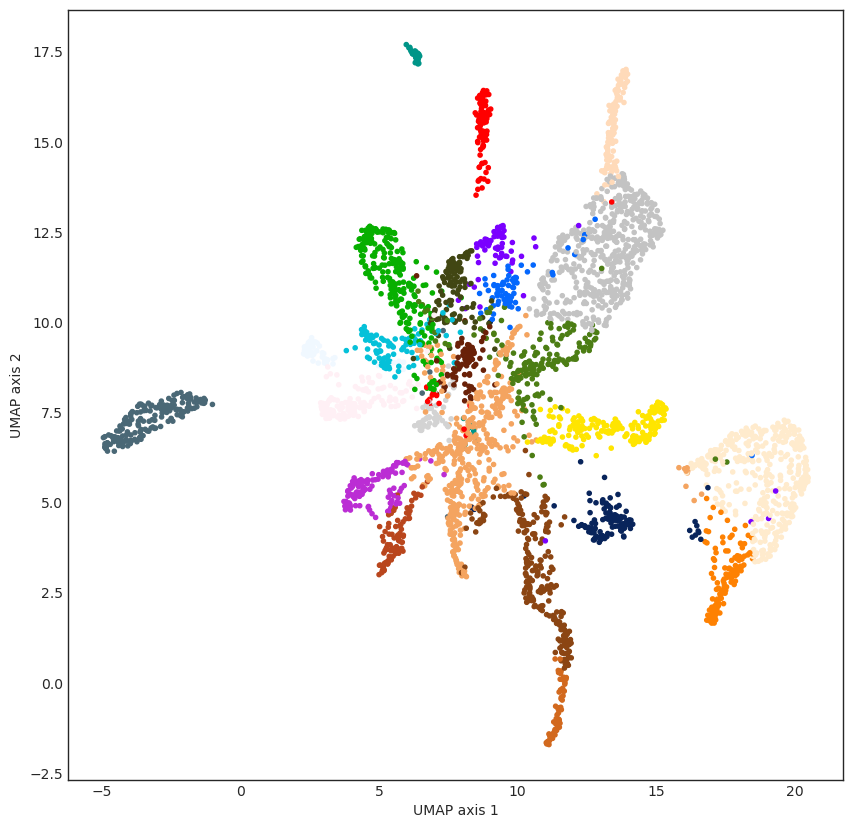

METHOD:  unweight  N_components:  36
(3780, 36) (36, 4230461) matrixes loaded for n_components 36


<Figure size 640x480 with 0 Axes>

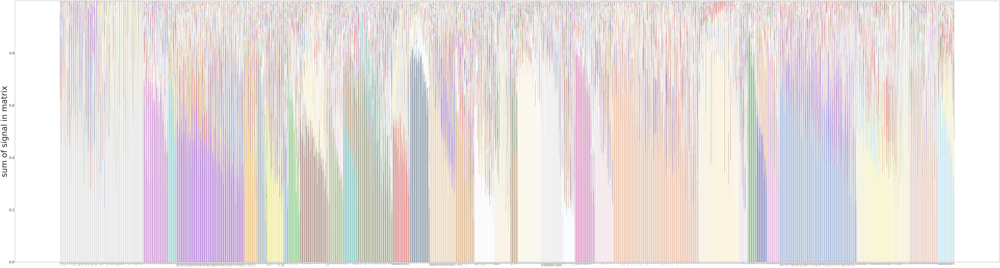

<Figure size 640x480 with 0 Axes>

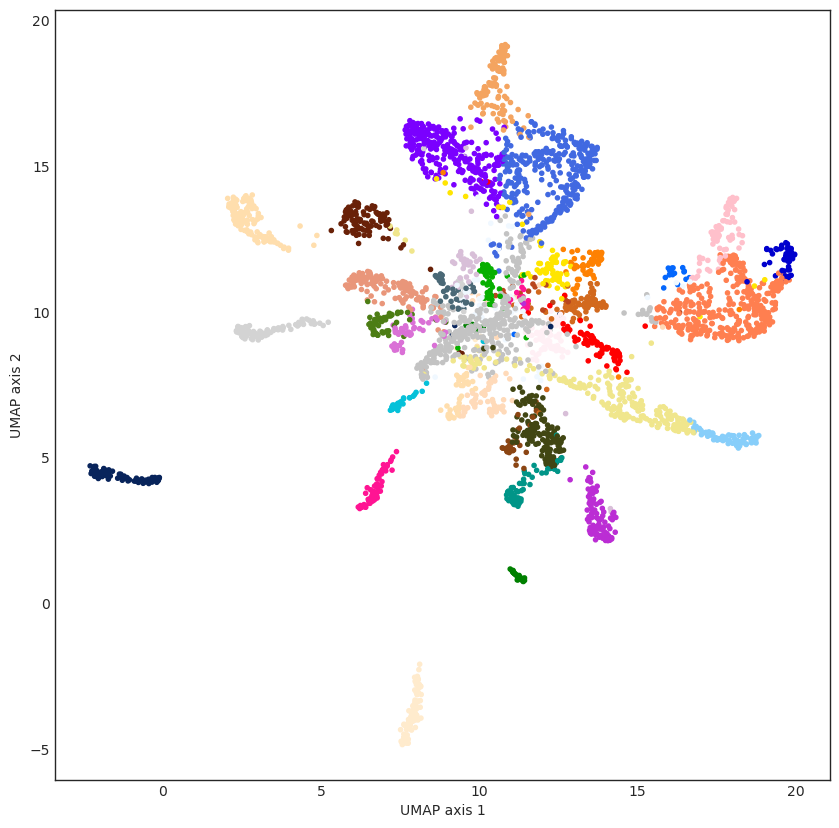

In [42]:
methods_range = ["unweight"]
#NC_ar = [4,8,10,12,16,18,20,24,28,32,36]
NC_ar = [8, 16, 24, 36]
data_slice_size = "full"

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.NormedBasis)
        decomp.define_colors()

        # Normolized stacked barplot
        decomp.make_stacked_bar_plot_sorted(decomp.NormedBasis.shape[0], 
                         decomp.NormedBasis.T, 
                         dir_path_figures + prefix + '.stacked_bar_plot.normed.pdf', 
                         names=np.array(allnames), 
                         barsortorder=bar_graph_sort_order)

        # UMAP 
        majcomp = np.argmax(decomp.Basis, axis=1)
        majcomp_no1 = np.argmax(decomp.Basis[:,1:], axis=1)+1
        
        reducer = umap.UMAP(min_dist=0.5, n_neighbors=200, random_state=20)
        embedding = reducer.fit_transform(decomp.Basis)

        plt.clf()
        plt.figure(figsize=(10,10))
        decomp.define_colors()
        plt.scatter(embedding[:,0], embedding[:,1], color=np.array(decomp.Comp_colors)[majcomp], alpha=1, marker='.')
        plt.ylabel('UMAP axis 2')
        plt.xlabel('UMAP axis 1')
        plt.savefig(dir_path_figures + prefix + '.umap.pdf', )
        plt.show()

METHOD:  unweight  N_components:  13
(3780, 13) (13, 4230461) matrixes loaded for n_components 13
Number of samples in this category  198
Number of samples in this category  768
Number of samples in this category  222
Number of samples in this category  128
Number of samples in this category  198
Number of samples in this category  243
Number of samples in this category  317
Number of samples in this category  657
Number of samples in this category  433
Number of samples in this category  103
Number of samples in this category  160
Number of samples in this category  137
Number of samples in this category  216


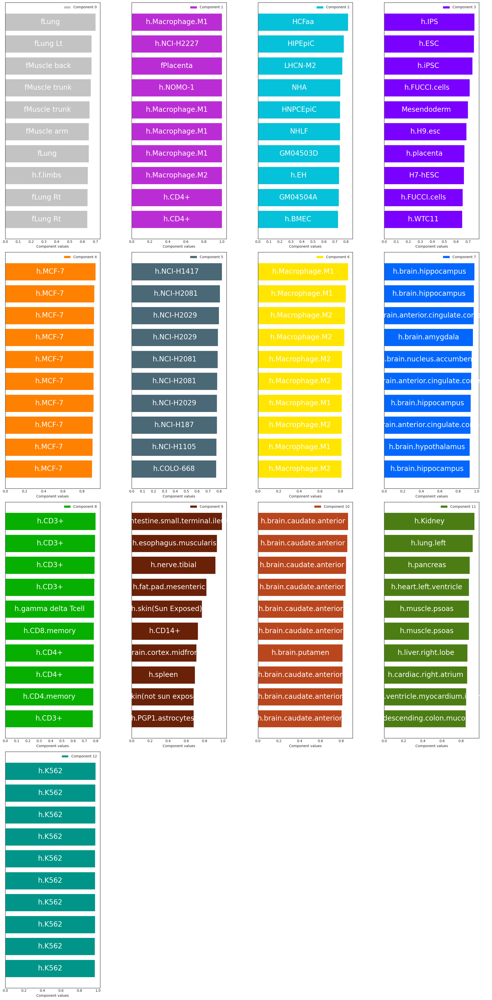

METHOD:  unweight  N_components:  16
(3780, 16) (16, 4230461) matrixes loaded for n_components 16
Number of samples in this category  138
Number of samples in this category  146
Number of samples in this category  130
Number of samples in this category  127
Number of samples in this category  152
Number of samples in this category  229
Number of samples in this category  599
Number of samples in this category  211
Number of samples in this category  359
Number of samples in this category  236
Number of samples in this category  180
Number of samples in this category  664
Number of samples in this category  190
Number of samples in this category  202
Number of samples in this category  107
Number of samples in this category  110


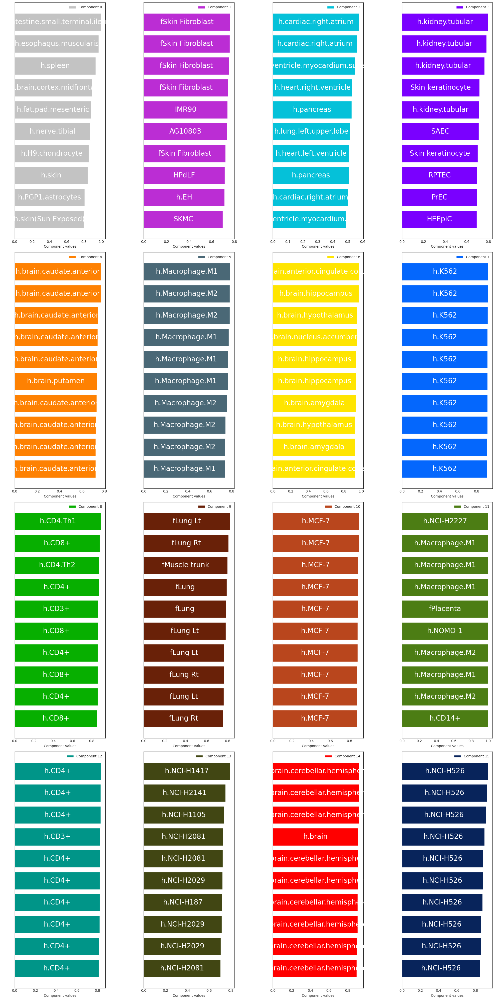

METHOD:  unweight  N_components:  24
(3780, 24) (24, 4230461) matrixes loaded for n_components 24
Number of samples in this category  491
Number of samples in this category  116
Number of samples in this category  97
Number of samples in this category  70
Number of samples in this category  124
Number of samples in this category  181
Number of samples in this category  189
Number of samples in this category  73
Number of samples in this category  245
Number of samples in this category  84
Number of samples in this category  85
Number of samples in this category  188
Number of samples in this category  36
Number of samples in this category  111
Number of samples in this category  100
Number of samples in this category  121
Number of samples in this category  441
Number of samples in this category  69
Number of samples in this category  131
Number of samples in this category  112
Number of samples in this category  239
Number of samples in this category  378
Number of samples in this cat

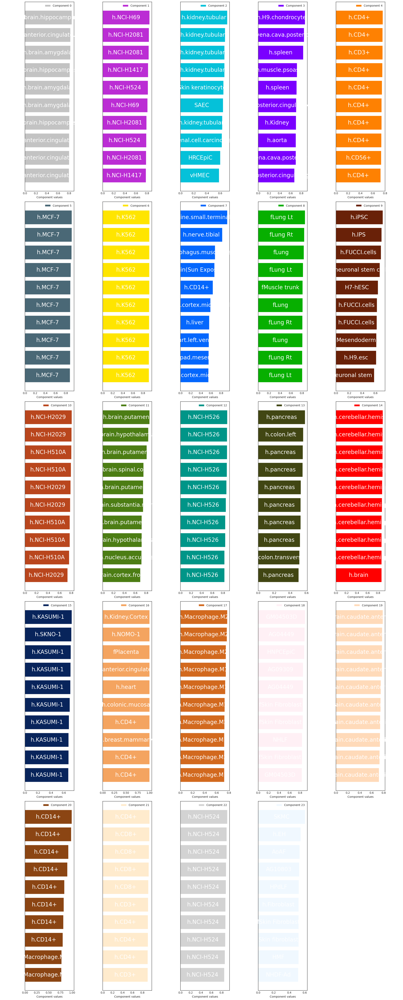

In [89]:
methods_range = ["unweight"]
NC_ar = [13, 16, 24]
data_slice_size = "full"

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.define_colors()
        
        
        ### Iterpretation part
        # Determine the number of rows and columns for the subplots
        nrows = int(np.ceil(np.sqrt(n_components)))
        ncols =int(np.ceil(n_components / nrows))

        # Create a figure with subplots
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 10 * nrows))
        axes = axes.flatten()  # Flatten the axes array to easily loop through

        for i_component in range(n_components):
            # Plot i_component major
            green_cut = np.argmax(decomp.Basis, axis=1) == i_component
            print("Number of samples in this category ", len(green_cut[green_cut]))

            if len(green_cut[green_cut]) >= 10: # if not, there are too few samples to count 10% top
                # Plot top 10% of this major as described:
                colors = colors_order
                decomp_NormedBasis = decomp.NormedBasis[green_cut] 

                # Get the top 10% of samples
                #top_percentage = 0.1
                top_count = 10 #int(decomp_NormedBasis.shape[0] * top_percentage)

                # Sort the samples by the value of the i_component
                sorted_indices = np.argsort(decomp_NormedBasis[:, i_component])[-top_count:]
                sorted_matrix = decomp_NormedBasis[sorted_indices, :]
                sorted_names = np.array(allnames)[green_cut][sorted_indices]

                # Create a horizontal stacked bar plot on the subplot
                ax = axes[i_component]
                ax.barh(np.arange(top_count), sorted_matrix[:, i_component], color=colors[i_component % len(colors)], label=f'Component {i_component}')

                # Add labels to the plot
                for i, name in enumerate(sorted_names):
                    ax.text(sorted_matrix[i, i_component] / 2, i, name, ha='center', va='center', color='white', fontsize=20)

                # Customize the plot
                ax.set_yticks(np.arange(top_count))
                ax.set_yticklabels([])
                ax.legend(loc='upper right')
                ax.set_xlabel('Component values')
                #ax.set_ylabel('Top 10% samples')
                #ax.set_title(f'Horizontal bar plot for top 10% samples (Component {i_component})')

            else:
                continue

        # Remove unused subplots
        for i in range(i_component + 1, len(axes)):
            fig.delaxes(axes[i])

        # Adjust layout and show the figure
        fig.tight_layout()
        #plt.savefig(dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.iterpretation.10barplot.png', bbox_inches='tight')
        plt.show()



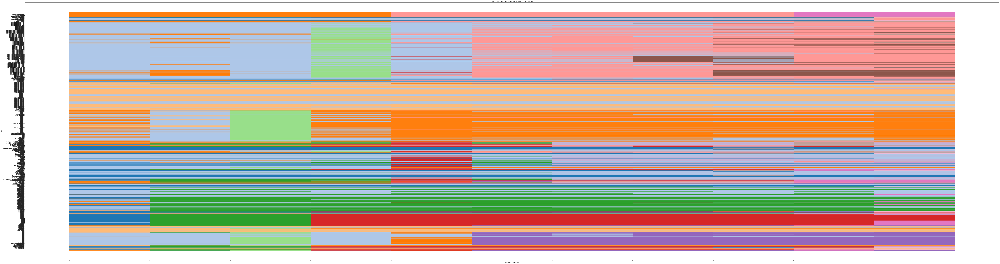

In [83]:
component_range = range(4, 15) 
plot_major_components(dir_path_pipeline, component_range, allnames)

In [82]:
from sklearn.metrics.pairwise import cosine_similarity

def plot_major_components(dir_path_pipeline, component_range, allnames, figdim1=150, figdim2=200):
    N_samples = 3780  # Number of samples to consider
    major_components_per_n = []
    color_mapping = {}  # Mapping between components and colors

    # Define a pool of colors
    color_pool = plt.cm.tab20(np.linspace(0, 1, 20))

    # Loop through different numbers of components
    previous_major_components = None
    
    # Store color mappings for each number of components
    color_mappings_per_n = []
    for n_idx, n_components in enumerate(component_range):

        prefix = "bin_new_unweight_full." + str(n_components)

        # Load Basis matrix
        Basis_path = dir_path_pipeline + prefix + '.W.npy'
        Basis = np.load(Basis_path)[:N_samples, :]

        # Find the major component for each sample
        major_components = np.argmax(Basis, axis=1)

        # Create a binary matrix representing the major component for each sample
        major_component_matrix = np.zeros((n_components, N_samples))
        for sample_idx, comp_idx in enumerate(major_components):
            major_component_matrix[comp_idx, sample_idx] = 1

        # Match components to colors based on similarity with previous number of components
        if previous_major_components is not None:
            similarity = cosine_similarity(major_component_matrix, previous_major_components)
            new_color_mapping = {}
            for prev_comp_idx in range(previous_major_components.shape[0]):
                most_similar_new_comp = np.argmax(similarity[:, prev_comp_idx])
                color = color_mapping[prev_comp_idx]
                new_color_mapping[most_similar_new_comp] = color

            # Assign new colors for unmatched components
            unmatched_comps = set(range(n_components)) - set(new_color_mapping.keys())
            for comp_idx in unmatched_comps:
                new_color_mapping[comp_idx] = color_pool[len(new_color_mapping)]

            color_mapping = new_color_mapping.copy()
        else:
            for comp_idx in range(n_components):
                color_mapping[comp_idx] = color_pool[comp_idx]

        previous_major_components = major_component_matrix.copy()  # Save for the next iteration
        major_components_per_n.append(major_components)
        color_mappings_per_n.append(color_mapping.copy())

    # Plotting
    plt.figure(figsize=(figdim1, figdim2))
    for sample_idx in range(N_samples):
        for n_idx, n_components in enumerate(component_range):
            major_component = major_components_per_n[n_idx][sample_idx]
            color_mapping_for_n = color_mappings_per_n[n_idx]
            color = color_mapping_for_n[major_component]
            plt.hlines(sample_idx, n_idx, n_idx+1, colors=color, lw=40)

    plt.yticks(np.arange(N_samples), allnames[:N_samples])
    plt.xticks(np.arange(len(component_range)), component_range)
    plt.xlabel('Number of Components')
    plt.ylabel('Samples')
    plt.title('Major Component per Sample and Number of Components')
    plt.show()


In [97]:
def plot_major_components(dir_path_pipeline, component_range, allnames, figdim1=150, figdim2=200):
    N_samples = 3780  # Number of samples to consider
    major_components_per_n = []
    color_mapping = {}  # Mapping between components and colors

    # Define a pool of colors
    color_pool = plt.cm.tab20(np.linspace(0, 1, 20))
    #color_pool = plt.cm.viridis(np.linspace(0, 1, 20))

    # Loop through different numbers of components
    previous_major_components = None
    
    # Store color mappings for each number of components
    color_mappings_per_n = []
    for n_idx, n_components in enumerate(component_range):

        prefix = "bin_new_unweight_full." + str(n_components)

        # Load Basis matrix and consider only the first 10 samples
        Basis_path = dir_path_pipeline + prefix + '.W.npy'
        Basis = np.load(Basis_path)[:N_samples, :]

        # Find the major component for each sample
        major_components = np.argmax(Basis, axis=1)

        # Create sets of samples for each component
        major_component_sets = [set(np.where(major_components == comp_idx)[0]) for comp_idx in range(n_components)]
        
        #print(major_component_sets)
        #print(previous_major_components)

        # Match components to colors based on intersection size with previous number of components
        if previous_major_components is not None:
            new_color_mapping = {}
            for prev_comp_idx, prev_set in enumerate(previous_major_components):
                # Find the new component with the largest intersection
                intersection_sizes = [len(prev_set & new_set) for new_set in major_component_sets]
                #print(intersection_sizes)
                most_similar_new_comp = np.argmax(intersection_sizes)
                #print(most_similar_new_comp)
                color = color_mapping[prev_comp_idx]
                new_color_mapping[most_similar_new_comp] = color

            # Assign new colors for unmatched components
            unmatched_comps = set(range(n_components)) - set(new_color_mapping.keys())
            for comp_idx in unmatched_comps:
                new_color_mapping[comp_idx] = color_pool[len(new_color_mapping)]

            color_mapping = new_color_mapping.copy()
        else:
            for comp_idx in range(n_components):
                color_mapping[comp_idx] = color_pool[comp_idx]
        '''         
        for comp_idx, color in color_mapping.items():
            print(f"  Component {comp_idx}: {color}")
        '''

        previous_major_components = major_component_sets  
        major_components_per_n.append(major_components)
        color_mappings_per_n.append(color_mapping.copy())

    # Plotting
    plt.figure(figsize=(figdim1, figdim2))
    for sample_idx in range(N_samples):
        for n_idx, n_components in enumerate(component_range):
            major_component = major_components_per_n[n_idx][sample_idx]
            color_mapping_for_n = color_mappings_per_n[n_idx]
            color = color_mapping_for_n[major_component]
            plt.hlines(sample_idx, n_idx, n_idx+1, colors=color, lw=40)

    plt.yticks(np.arange(N_samples), allnames[:N_samples])
    plt.xticks(np.arange(len(component_range)), component_range)
    plt.xlabel('Number of Components')
    plt.ylabel('Samples')
    plt.title('Major Component per Sample and Number of Components')
    plt.show()



In [98]:
component_range = range(4, 15)  # From 4 to 20 components
plot_major_components(dir_path_pipeline, component_range, allnames)

# DHS analysis

METHOD:  unweight  N_components:  16
(3780, 16) (16, 4230461) matrixes loaded for n_components 16
(10000, 16) (16, 3780) matrixes loaded for n_components 16


<Figure size 640x480 with 0 Axes>

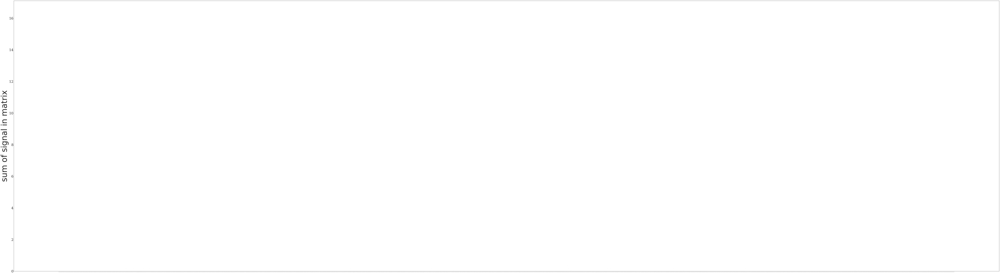

<Figure size 640x480 with 0 Axes>

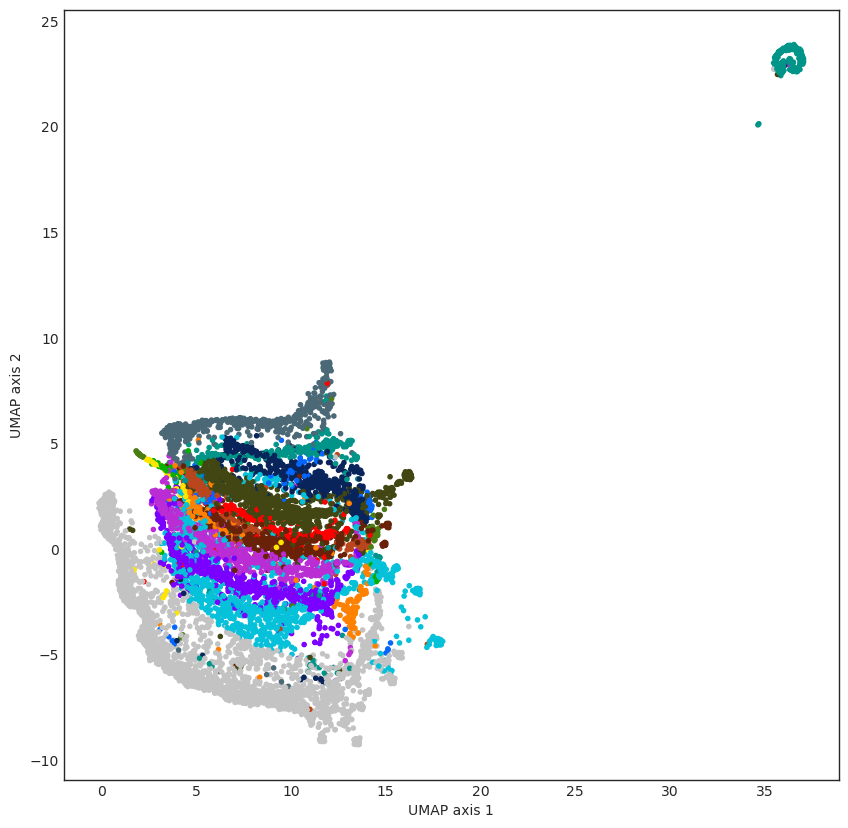

METHOD:  unweight  N_components:  24
(3780, 24) (24, 4230461) matrixes loaded for n_components 24
(10000, 24) (24, 3780) matrixes loaded for n_components 24


<Figure size 640x480 with 0 Axes>

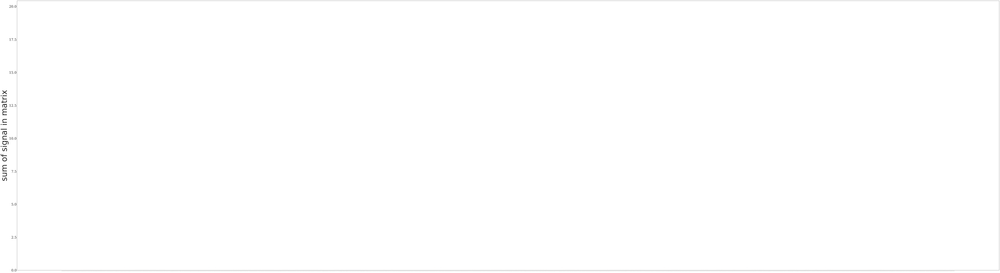

<Figure size 640x480 with 0 Axes>

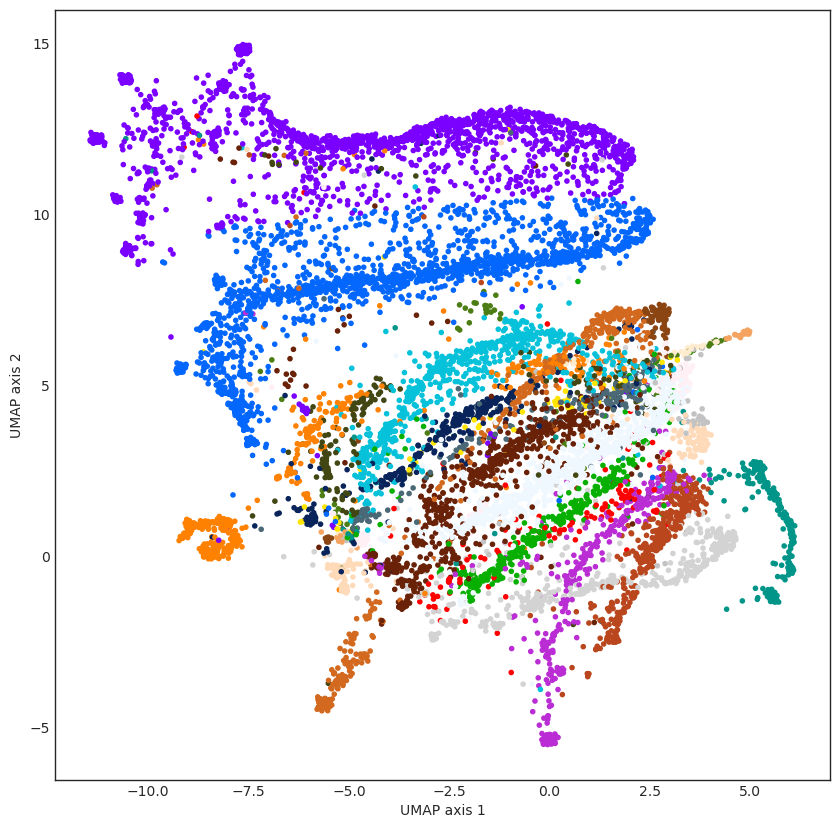

In [45]:
methods_range = ["unweight"]
NC_ar = [16, 24]
sample_size = 10000

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.define_colors()
        
        seed_value = 56
        np.random.seed(seed_value)
        
        # Random sampling
        num_columns = decomp.Mixture.shape[1]
        random_indices = np.random.choice(num_columns, sample_size, replace=False)
        random_sample = decomp.Mixture[:, random_indices]
        
        # HERE SHENANIGANS STARTS!
        # In general the random_sample is OONMF object with a DHS-by-components matrix as a Basis matrix
        np.save(dir_path_pipeline + prefix +'.H.random.npy', random_sample.T)
        random_sample = OONMF.NMFobject(n_components)
        random_sample.matrix_input_name(dir_path_pipeline + prefix +'.H.random.npy',
                                        dir_path_pipeline + prefix +'.W.npy')
        random_sample.read_matrix_input(compressed=False)
        random_sample.Mixture = random_sample.Mixture.T
        print(random_sample.Basis.shape, random_sample.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        random_sample.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(random_sample.Basis)
        random_sample.define_colors()
        '''   
        # heatmap
        decomp.make_standard_heatmap_plot(random_sample.Basis.shape[0], 
                                  random_sample.Basis, 
                                  dir_path_figures + prefix +'.DHS.heatmap.pdf', 
                                  #names=np.array(allnames), 
                                  barsortorder= bar_graph_sort_order)
        # Stacked barplot
        decomp.make_stacked_bar_plot_sorted(random_sample.Basis.shape[0], 
                         random_sample.Basis.T, 
                         dir_path_figures + prefix+'.DHS.stacked_bar_plot.pdf', 
                         #names=np.array(allnames), 
                         barsortorder=bar_graph_sort_order)
        '''
      

        decomp = random_sample
        
        majcomp = np.argmax(decomp.Basis, axis=1)
        majcomp_no1 = np.argmax(decomp.Basis[:,1:], axis=1)+1
        
        reducer = umap.UMAP(min_dist=0.5, n_neighbors=200, random_state=20)
        embedding = reducer.fit_transform(decomp.Basis)

        plt.clf()
        plt.figure(figsize=(10,10))
        decomp.define_colors()
        plt.scatter(embedding[:,0], embedding[:,1], color=np.array(decomp.Comp_colors)[majcomp], alpha=1, marker='.')
        plt.ylabel('UMAP axis 2')
        plt.xlabel('UMAP axis 1')
        plt.savefig(dir_path_figures + prefix + '.DHS.umap.pdf', )
        plt.show()
        
        

METHOD:  unweight  N_components:  16
(3780, 16) (16, 4230461) matrixes loaded for n_components 16
Time to find major components:  0.16727781295776367
Time to count major components:  0.009196996688842773


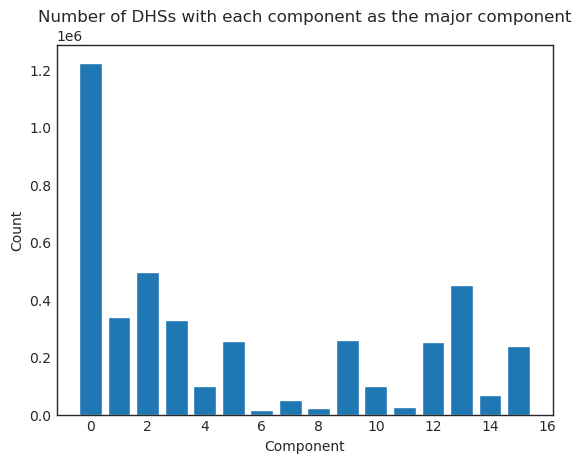

Time to find major components over 80 percent:  0.5357084274291992
Time to count major components over 80 percent:  0.0034797191619873047
Time taken for calculation of major components and their values:  0.5784077644348145
Time taken for calculation of total sum:  0.08985018730163574
Time taken for calculation of total component counts:  0.009208917617797852
Time taken for calculation of major components over 80%:  0.0608518123626709
Time taken for calculation of major components over 70%:  0.06718897819519043
Time taken for calculation of major components over 60%:  0.06138753890991211
Time taken for calculation of major components over 50%:  0.05208015441894531
Time taken for calculation of major components over 30%:  0.05069899559020996
Time taken for calculation of major components over 25%:  0.02906656265258789
Time taken for calculation of major components over 20%:  0.0478518009185791
Time taken for calculation of major components over 15%:  0.02891826629638672
Time taken for ca

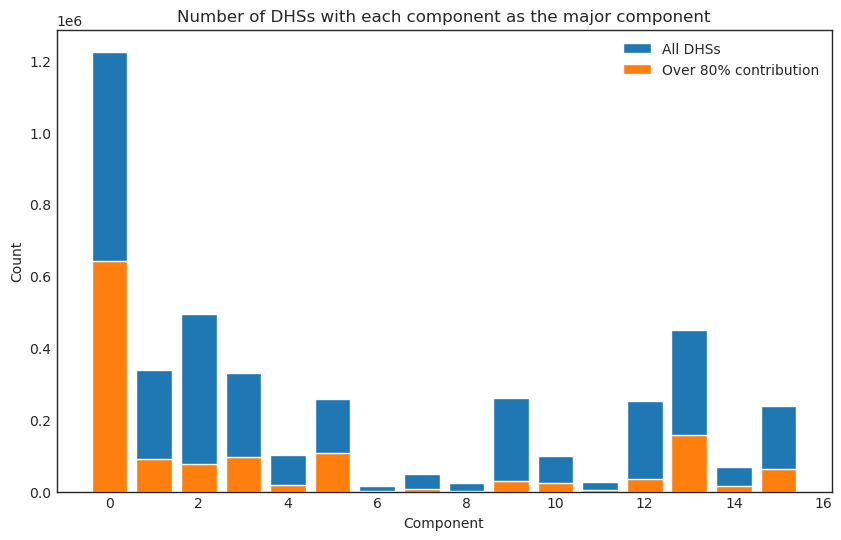

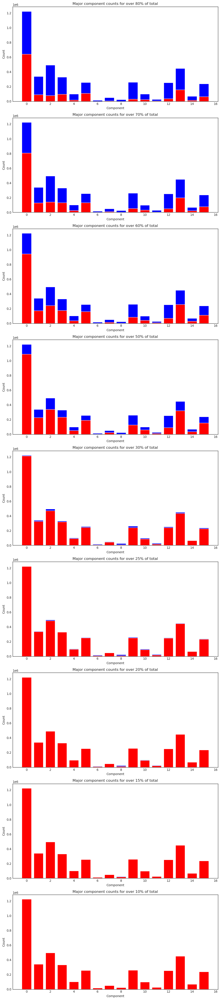

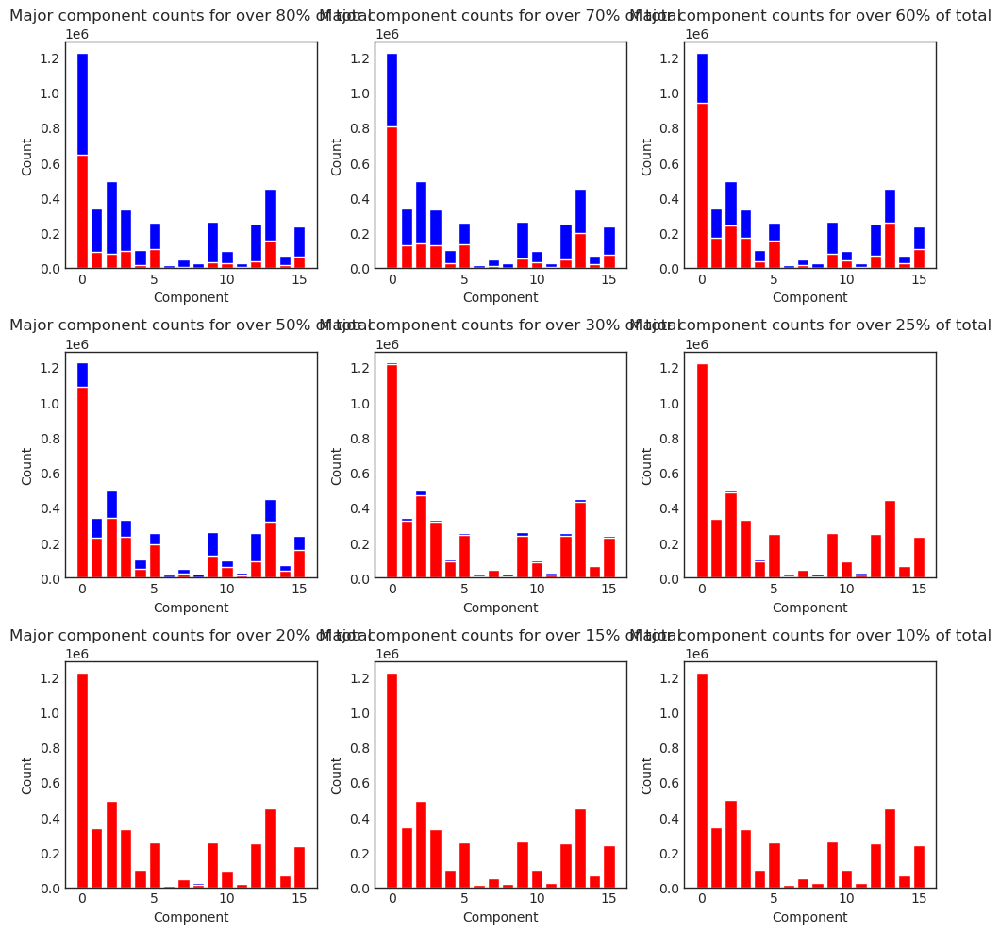

In [44]:
methods_range = ["unweight"]
NC_ar = [16]#, 24]


for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        start_time = time.time()
        major_components = np.argmax(decomp.Mixture, axis=0)
        print("Time to find major components: ", time.time() - start_time)

        start_time = time.time()
        component_counts = np.bincount(major_components) # Count how many DHSs have each component as their major component
        print("Time to count major components: ", time.time() - start_time)

        plt.bar(range(len(component_counts)), component_counts)
        plt.xlabel('Component')
        plt.ylabel('Count')
        plt.title('Number of DHSs with each component as the major component')
        plt.savefig(dir_path_figures + prefix + 'dhs_major_components.png')
        plt.show()
        
        # Count how many DHSs have each component as their major component with more than 80% contribution
        start_time = time.time()
        major_component_values = np.max(decomp.Mixture, axis=0)
        over_80_percent = major_component_values > 0.8 * np.sum(decomp.Mixture, axis=0)
        major_components_over_80_percent = major_components[over_80_percent]
        end_time = time.time()
        print("Time to find major components over 80 percent: ", end_time - start_time)
        start_time = time.time()
        component_counts_over_80_percent = np.bincount(major_components_over_80_percent)
        end_time = time.time()
        print("Time to count major components over 80 percent: ", end_time - start_time)

        plt.figure(figsize=(10, 6))
        plt.bar(range(len(component_counts)), component_counts, label='All DHSs')
        plt.bar(range(len(component_counts_over_80_percent)), component_counts_over_80_percent, label='Over 80% contribution')
        plt.xlabel('Component')
        plt.ylabel('Count')
        plt.title('Number of DHSs with each component as the major component')
        plt.legend()
        plt.savefig(dir_path_figures + prefix + 'dhs_major_components_with_over_80_percent.png')

        # These are the percentages you're interested in
        percentages = [80, 70, 60, 50, 30, 25, 20, 15, 10]

        # Initialize a figure and axes for subplots
        fig, axs = plt.subplots(len(percentages), 1, figsize=(10, 5*len(percentages)))

        # Calculate the major components and their values
        start_time = time.time()
        major_components = np.argmax(decomp.Mixture, axis=0)
        major_component_values = np.max(decomp.Mixture, axis=0)
        print("Time taken for calculation of major components and their values: ", time.time() - start_time)

        # Total sum of components for each DHS
        start_time = time.time()
        total_sum = np.sum(decomp.Mixture, axis=0)
        print("Time taken for calculation of total sum: ", time.time() - start_time)

        # Counts of each major component
        start_time = time.time()
        total_component_counts = np.bincount(major_components)
        print("Time taken for calculation of total component counts: ", time.time() - start_time)

        for i, percent in enumerate(percentages):
            # Calculate the boolean array for this percentage
            start_time = time.time()
            over_percent = major_component_values > (percent/100) * total_sum

            # Get the major components where the condition is met
            major_components_over_percent = major_components[over_percent]

            # Count the occurrences of each component
            over_percent_counts = np.bincount(major_components_over_percent)
            print(f"Time taken for calculation of major components over {percent}%: ", time.time() - start_time)

            # Plot the counts
            axs[i].bar(range(len(total_component_counts)), total_component_counts, color='b')
            axs[i].bar(range(len(over_percent_counts)), over_percent_counts, color='r')
            axs[i].set_title(f'Major component counts for over {percent}% of total')
            axs[i].set_xlabel('Component')
            axs[i].set_ylabel('Count')
        # Adjust the layout
        plt.tight_layout()

        # Save the figure
        plt.savefig(dir_path_figures + prefix + "major_components_for different percentages.png")
        
        # These are the percentages you're interested in
        percentages = [80, 70, 60, 50, 30, 25, 20, 15, 10]

        # Initialize a figure and axes for subplots
        fig, axs = plt.subplots(3, 3, figsize=(10, 10))  

        # Calculate the major components and their values
        start_time = time.time()
        major_components = np.argmax(decomp.Mixture, axis=0)
        major_component_values = np.max(decomp.Mixture, axis=0)
        print("Time taken for calculation of major components and their values: ", time.time() - start_time)

        # Total sum of components for each DHS
        start_time = time.time()
        total_sum = np.sum(decomp.Mixture, axis=0)
        print("Time taken for calculation of total sum: ", time.time() - start_time)

        # Counts of each major component
        start_time = time.time()
        total_component_counts = np.bincount(major_components)
        print("Time taken for calculation of total component counts: ", time.time() - start_time)

        for i, percent in enumerate(percentages):
            # Calculate the boolean array for this percentage
            start_time = time.time()
            over_percent = major_component_values > (percent/100) * total_sum

            # Get the major components where the condition is met
            major_components_over_percent = major_components[over_percent]

            # Count the occurrences of each component
            over_percent_counts = np.bincount(major_components_over_percent)
            print(f"Time taken for calculation of major components over {percent}%: ", time.time() - start_time)

            # Plot the counts
            axs[i // 3, i % 3].bar(range(len(total_component_counts)), total_component_counts, color='b')
            axs[i // 3, i % 3].bar(range(len(over_percent_counts)), over_percent_counts, color='r')
            axs[i // 3, i % 3].set_title(f'Major component counts for over {percent}% of total')
            axs[i // 3, i % 3].set_xlabel('Component')
            axs[i // 3, i % 3].set_ylabel('Count')

        # Adjust the layout
        plt.tight_layout()
        plt.show()

        # Save the figure
        #plt.savefig("major_components_counts.png")


METHOD:  unweight  N_components:  16
(10000, 16) (16, 3780) matrixes loaded for n_components 16


<Figure size 640x480 with 0 Axes>

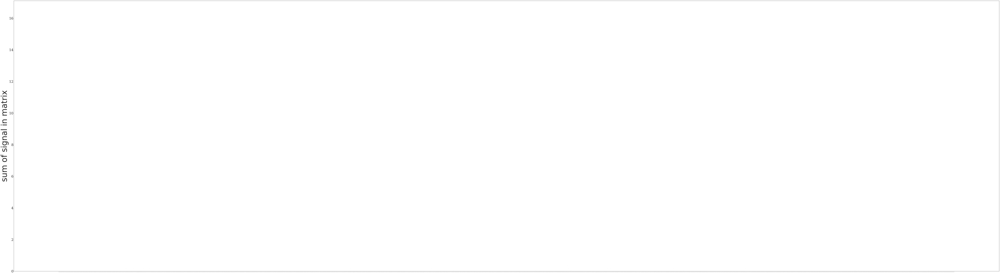

In [95]:
# first on sample
methods_range = ["unweight"]
NC_ar = [16]

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)

        random_sample = OONMF.NMFobject(n_components)
        random_sample.matrix_input_name(dir_path_pipeline + prefix +'.H.random.npy',
                                        dir_path_pipeline + prefix +'.W.npy')
        random_sample.read_matrix_input(compressed=False)
        random_sample.Mixture = random_sample.Mixture.T
        print(random_sample.Basis.shape, random_sample.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        random_sample.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(random_sample.Basis)
        random_sample.define_colors()
        '''   
        # heatmap
        decomp.make_standard_heatmap_plot(random_sample.Basis.shape[0], 
                                  random_sample.Basis, 
                                  dir_path_figures + prefix +'.DHS.heatmap.pdf', 
                                  #names=np.array(allnames), 
                                  barsortorder= bar_graph_sort_order)
        '''
        # Stacked barplot
        random_sample.make_stacked_bar_plot_sorted(random_sample.Basis.shape[0], 
                         random_sample.Basis.T, 
                         dir_path_figures + prefix+'.DHS.stacked_bar_plot.pdf', 
                         #names=np.array(allnames), 
                         barsortorder=bar_graph_sort_order)
        

In [97]:
def swap_basis_mixture(self):
    self.Basis, self.Mixture = self.Mixture.T, self.Basis.T

In [98]:
OONMF.NMFobject.swap_basis_mixture = swap_basis_mixture

METHOD:  unweight  N_components:  16
(3780, 16) (16, 4230461) matrixes loaded for n_components 16
(4230461, 16) (16, 3780) matrixes loaded for n_components 16


KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

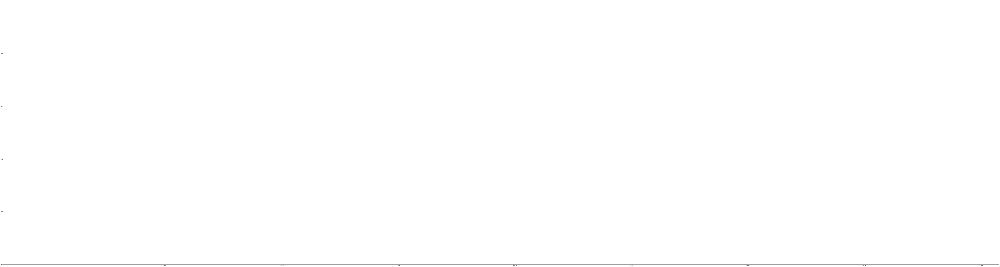

In [102]:
# try again
data_slice_size = "full"
methods_range = ["unweight"]
NC_ar = [16]

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp.swap_basis_mixture()
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.define_colors()

        # Normalized stacked barplot
        decomp.make_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                         decomp.NormedBasis.T, 
                         dir_path_figures + prefix + '.DHS.stacked_bar_plot.normed.pdf', 
                         names=np.array(allnames), 
                         barsortorder=bar_graph_sort_order)
        

In [76]:
methods_range = ["unweight"]
NC_ar = [16]

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.H.npy',
                                dir_path_pipeline + prefix +'.W.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.define_colors()
        
        '''
        # heatmap
        decomp.make_standard_heatmap_plot(random_sample.Basis.shape[0], 
                                  random_sample.Basis, 
                                  dir_path_figures + prefix +'.DHS.heatmap.pdf', 
                                  #names=np.array(allnames), 
                                  barsortorder= bar_graph_sort_order)
        '''
        # Stacked barplot
        decomp.make_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                         decomp.Basis.T, 
                         dir_path_figures + prefix+'.DHS.stacked_bar_plot.pdf', 
                         #names=np.array(allnames), 
                         barsortorder=bar_graph_sort_order)
        
      

METHOD:  unweight  N_components:  16
(16, 4230461) (3780, 16) matrixes loaded for n_components 16


IndexError: list index out of range

<Figure size 640x480 with 0 Axes>

<Figure size 15000x4000 with 0 Axes>

# DHS clustering

## K-means

In [ ]:
methods_range = ["unweight"]
NC_ar = [16]  # Modify this to include other values if needed
num_dhs_subsampled = 100000

for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        num_cols_subsampled = min(num_dhs_subsampled, dhs_component_matrix.shape[1])
        col_indices_subsampled = np.random.choice(
            dhs_component_matrix.shape[1], size=num_cols_subsampled, replace=False
        )
        dhs_component_matrix_subsampled = dhs_component_matrix[:, col_indices_subsampled]
        print(dhs_component_matrix_subsampled.shape)

        dhs_component_matrix = dhs_component_matrix_subsampled

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T)  # Transpose the matrix

        # Calculate initial labels by getting the index of the maximum component for each data point
        initial_labels = np.argmax(dhs_component_matrix, axis=1)
        # Get the unique labels and count the number of unique labels
        unique_labels, counts = np.unique(initial_labels, return_counts=True)
        # Create initial centers based on the labels
        initial_centers = np.array([dhs_component_matrix[initial_labels == label].mean(axis=0) for label in unique_labels])

        # Perform clustering using K-means with custom initialization
        n_clusters = len(unique_labels)  
        kmeans = KMeans(n_clusters=n_clusters, init=initial_centers, random_state=42, n_init=1)
        cluster_labels = kmeans.fit_predict(dhs_component_matrix)
        
        print("Time taken: ", time.time() - start_time)
        start_time = time.time()

        # Perform dimensionality reduction using UMAP
        umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, random_state=42)
        umap_embedding = umap_reducer.fit_transform(dhs_component_matrix)

        # Create a color map for the clusters
        cmap = plt.cm.get_cmap('tab20', n_clusters)

        # Plot the clustering results
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                umap_embedding[cluster_labels == i, 0],
                umap_embedding[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}'
            )
        plt.title('UMAP Visualization of Clustering Results')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()

        # Create a histogram of the number of dots in each cluster
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels)
        plt.bar(range(n_clusters), counts, color=cmap(range(n_clusters)))
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

        # Compute the silhouette score
        silhouette = silhouette_score(dhs_component_matrix, cluster_labels)
        print(f"Silhouette score: {silhouette}")

        print("Time taken: ", time.time() - start_time)

In [72]:
from sklearn.cluster import MiniBatchKMeans

methods_range = ["unweight"]
NC_ar = [16]  

for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

        # Calculate initial labels by getting the index of the maximum component for each data point
        initial_labels = np.argmax(dhs_component_matrix, axis=1)
        unique_labels, counts = np.unique(initial_labels, return_counts=True) # Get the unique labels and count the number of unique labels
        # Create initial centers based on the labels
        initial_centers = np.array([dhs_component_matrix[initial_labels == label].mean(axis=0) for label in unique_labels])

        n_clusters = len(unique_labels)
        mbkmeans = MiniBatchKMeans(n_clusters=n_clusters, init=initial_centers, random_state=42, batch_size=1000, n_init=1)
        cluster_labels = mbkmeans.fit_predict(dhs_component_matrix)

        print("Time taken: ", time.time() - start_time)
        start_time = time.time()

        # Perform dimensionality reduction using UMAP
        umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, random_state=42)
        umap_embedding = umap_reducer.fit_transform(dhs_component_matrix)

        # Create a color map for the clusters
        cmap = plt.cm.get_cmap('tab20', n_clusters)

        # Plot the clustering results
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                umap_embedding[cluster_labels == i, 0],
                umap_embedding[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}'
            )
        plt.title('UMAP Visualization of Clustering Results')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()

        # Create a histogram of the number of dots in each cluster
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels)
        plt.bar(range(n_clusters), counts, color=cmap(range(n_clusters)))
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

        # Compute the silhouette score
        silhouette = silhouette_score(dhs_component_matrix, cluster_labels)
        print(f"Silhouette score: {silhouette}")

        print("Time taken: ", time.time() - start_time)

METHOD:  unweight  N_components:  16
Time taken:  3.4107794761657715


KeyboardInterrupt: 

METHOD:  unweight  N_components:  16
Time taken:  2.4812488555908203


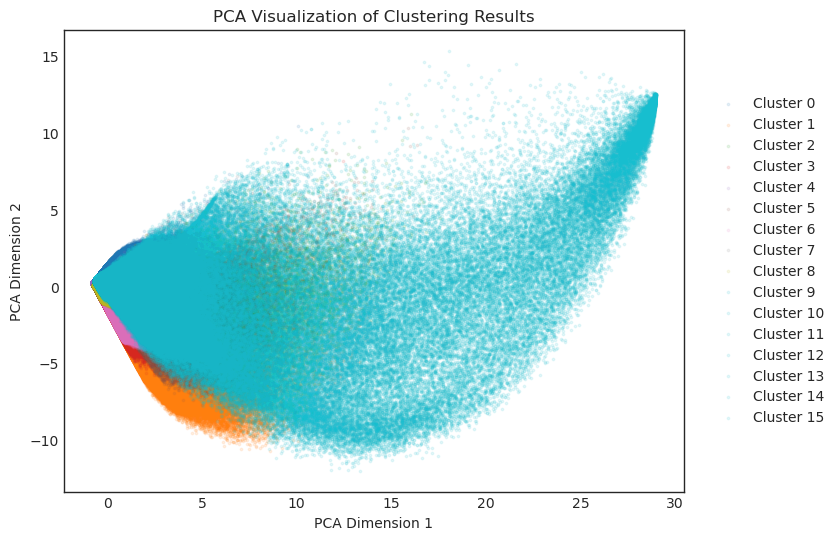

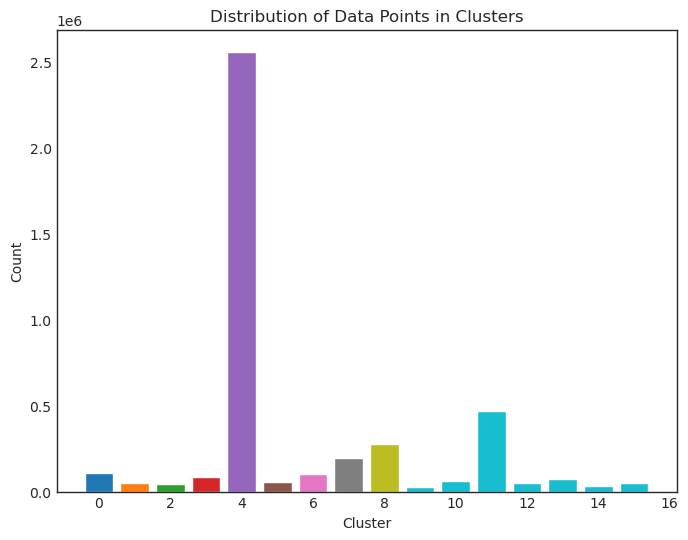

In [34]:

methods_range = ["unweight"]
NC_ar = [16]  

for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

        # Calculate initial labels by getting the index of the maximum component for each data point
        initial_labels = np.argmax(dhs_component_matrix, axis=1)
        unique_labels, counts = np.unique(initial_labels, return_counts=True) # Get the unique labels and count the number of unique labels
        # Create initial centers based on the labels
        initial_centers = np.array([dhs_component_matrix[initial_labels == label].mean(axis=0) for label in unique_labels])

        n_clusters = len(unique_labels)
        mbkmeans = MiniBatchKMeans(n_clusters=n_clusters, init=initial_centers, random_state=42, batch_size=1000, n_init=1)
        cluster_labels = mbkmeans.fit_predict(dhs_component_matrix)

        print("Time taken: ", time.time() - start_time)
        start_time = time.time()

        # Perform dimensionality reduction using PCA
        pca = PCA(n_components=2, random_state=42)
        pca_embedding = pca.fit_transform(dhs_component_matrix)
        
        
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                pca_embedding[cluster_labels == i, 0],
                pca_embedding[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}',
                s=3,  # the marker size
                alpha=0.1  # the transparency
            )
        plt.title('PCA Visualization of Clustering Results')
        plt.xlabel('PCA Dimension 1')
        plt.ylabel('PCA Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()
        

        # Create a histogram of the number of dots in each cluster
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels)
        plt.bar(range(n_clusters), counts, color=cmap(range(n_clusters)))
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

        '''
        # Compute the silhouette score
        silhouette = silhouette_score(dhs_component_matrix, cluster_labels)
        print(f"Silhouette score: {silhouette}")

        print("Time taken: ", time.time() - start_time)
        '''

In [ ]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


methods_range = ["unweight"]
NC_ar = [16]  

for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

        # Calculate initial labels by getting the index of the maximum component for each data point
        initial_labels = np.argmax(dhs_component_matrix, axis=1)
        unique_labels, counts = np.unique(initial_labels, return_counts=True) # Get the unique labels and count the number of unique labels
        # Create initial centers based on the labels
        initial_centers = np.array([dhs_component_matrix[initial_labels == label].mean(axis=0) for label in unique_labels])

        n_clusters = len(unique_labels)
        mbkmeans = MiniBatchKMeans(n_clusters=n_clusters, init=initial_centers, random_state=42, batch_size=1000, n_init=1)
        cluster_labels = mbkmeans.fit_predict(dhs_component_matrix)

        print("Time taken: ", time.time() - start_time)
        start_time = time.time()

        '''
        # Perform initial dimensionality reduction using PCA
        pca = PCA(n_components=50, random_state=42)
        reduced_data = pca.fit_transform(dhs_component_matrix)
        '''

        # Perform dimensionality reduction using t-SNE
        tsne = TSNE(n_components=2, random_state=42)
        #tsne_embedding = tsne.fit_transform(reduced_data)
        tsne_embedding = tsne.fit_transform(dhs_component_matrix)

        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                tsne_embedding[cluster_labels == i, 0],
                tsne_embedding[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}'
            )
        plt.title('t-SNE Visualization of Clustering Results')
        plt.xlabel('t-SNE Dimension 1')
        plt.ylabel('t-SNE Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()


        # Create a histogram of the number of dots in each cluster
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels)
        plt.bar(range(n_clusters), counts, color=cmap(range(n_clusters)))
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

METHOD:  unweight  N_components:  16
Time taken:  3.1860814094543457


In [ ]:
methods_range = ["unweight"]
NC_ar = [16]  

# Loop over methods and components
for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print(f"METHOD: {method}, N_components: {n_components}")

        # Load data and perform preprocessing
        prefix = f"bin_new_{method}_{data_slice_size}.{n_components}"
        dhs_component_matrix = np.load(f"{dir_path_pipeline}{prefix}.H.npy")

        # Normalize data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T)

        # Dimensionality reduction
        pca = PCA(n_components=2)
        reduced_data = pca.fit_transform(dhs_component_matrix)
        print("pca done")

        # Clustering
        dbscan = DBSCAN(eps=0.5, min_samples=5)
        cluster_labels = dbscan.fit_predict(reduced_data)

        print(f"Time taken for clustering: {time.time() - start_time} seconds")

        # Number of clusters in labels, ignoring noise if present.
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        n_noise = list(cluster_labels).count(-1)

        # Create a color map for the clusters
        cmap = plt.cm.get_cmap('tab20', n_clusters)

        # Plotting PCA results
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(reduced_data[cluster_labels == i, 0], reduced_data[cluster_labels == i, 1],
                        color=cmap(i), label=f'Cluster {i}')
        plt.title('PCA Visualization of Clustering Results')
        plt.xlabel('PCA Dimension 1')
        plt.ylabel('PCA Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()

        # Plotting histogram of cluster distribution
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels + 1)  # Adding 1 to make -1 (noise) to 0 for bincount
        plt.bar(range(n_clusters), counts[1:], color=cmap(range(n_clusters)))  # Skipping count of noise
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

        print(f'Estimated number of clusters: {n_clusters}')
        print(f'Estimated number of noise points: {n_noise}')

METHOD: unweight, N_components: 16
pca done


In [15]:
methods_range = ["unweight"]
NC_ar = [16]  

# Loop over methods and components
for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print(f"METHOD: {method}, N_components: {n_components}")

        # Load data and perform preprocessing
        prefix = f"bin_new_{method}_{data_slice_size}.{n_components}"
        dhs_component_matrix = np.load(f"{dir_path_pipeline}{prefix}.H.npy")

        # Normalize data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T)

        # Dimensionality reduction
        pca = PCA(n_components=2)
        reduced_data = pca.fit_transform(dhs_component_matrix)
        print("pca done", reduced_data.shape)
        

METHOD: unweight, N_components: 16
pca done (4230461, 2)


METHOD:  unweight  N_components:  16
(16, 100000)
Time taken:  39.871005058288574
Estimated number of clusters: 44
Estimated number of noise points: 14355


/tmp/ipykernel_28129/64432852.py:43: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', n_clusters)


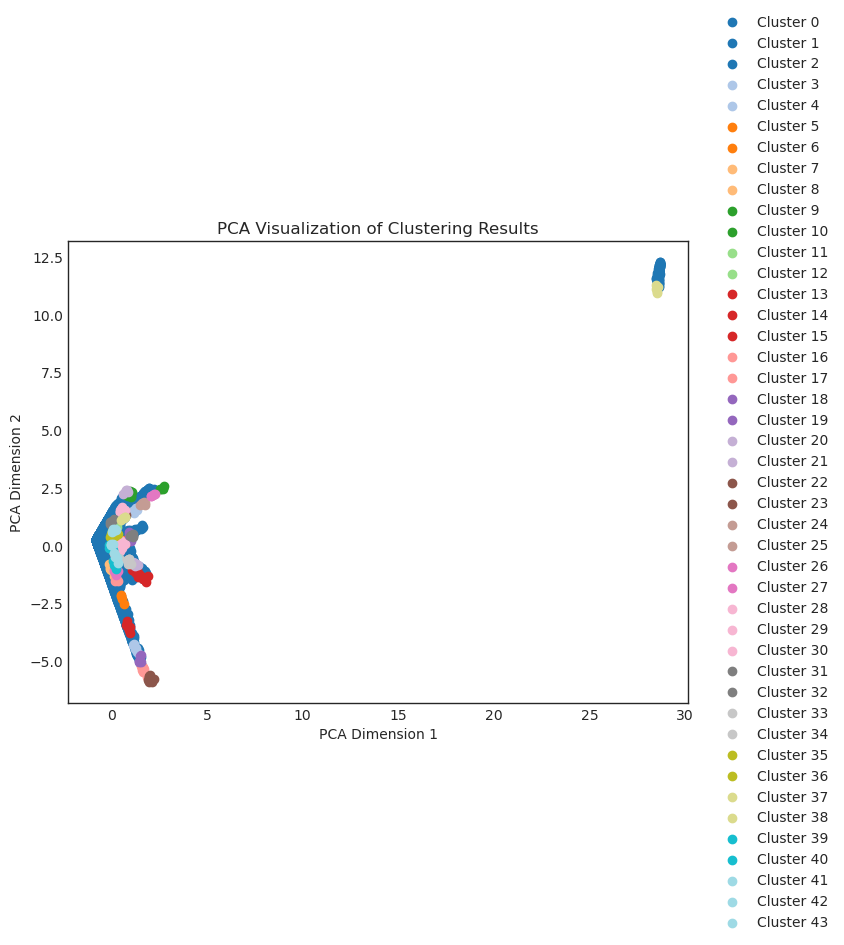

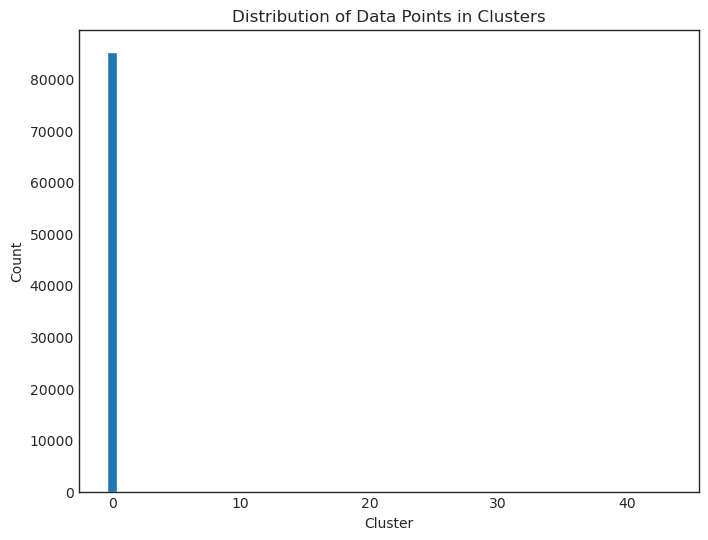

In [20]:
methods_range = ["unweight"]
NC_ar = [16]
num_dhs_subsampled = 100000

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        num_cols_subsampled = min(num_dhs_subsampled, dhs_component_matrix.shape[1])
        col_indices_subsampled = np.random.choice(
            dhs_component_matrix.shape[1], size=num_cols_subsampled, replace=False
        )
        dhs_component_matrix_subsampled = dhs_component_matrix[:, col_indices_subsampled]
        print(dhs_component_matrix_subsampled.shape)

        dhs_component_matrix = dhs_component_matrix_subsampled

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

        start_time = time.time()
        # Clustering with DBSCAN
        dbscan = DBSCAN(eps=0.5, min_samples=5)    # EPS!!!
        cluster_labels = dbscan.fit_predict(dhs_component_matrix)
        print("Time taken: ", time.time() - start_time)

        # Number of clusters in labels, ignoring noise if present.
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        n_noise = list(cluster_labels).count(-1)
        print(f'Estimated number of clusters: {n_clusters}')
        print(f'Estimated number of noise points: {n_noise}')

        # Dimensionality reduction for visualization
        pca = PCA(n_components=2)
        pca_result = pca.fit_transform(dhs_component_matrix)

        # Create a color map for the clusters
        cmap = plt.cm.get_cmap('tab20', n_clusters)

        # Plotting
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                pca_result[cluster_labels == i, 0],
                pca_result[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}'
            )
        plt.title('PCA Visualization of Clustering Results')
        plt.xlabel('PCA Dimension 1')
        plt.ylabel('PCA Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()

        # Plotting histogram of cluster distribution
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels + 1)  # Adding 1 to make -1 (noise) to 0 for bincount
        plt.bar(range(n_clusters), counts[1:], color=cmap(range(n_clusters)))  # Skipping count of noise
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

METHOD:  unweight  N_components:  16  Num Clusters:  4


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.4410133361816406


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


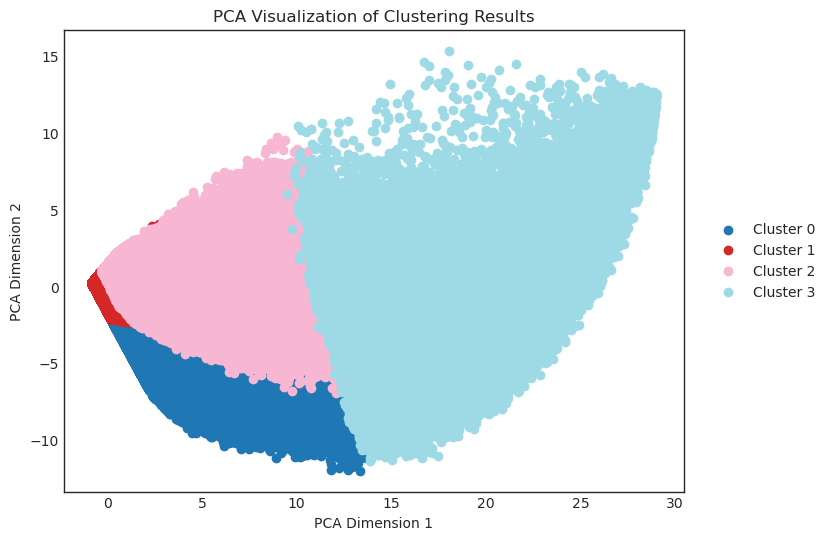

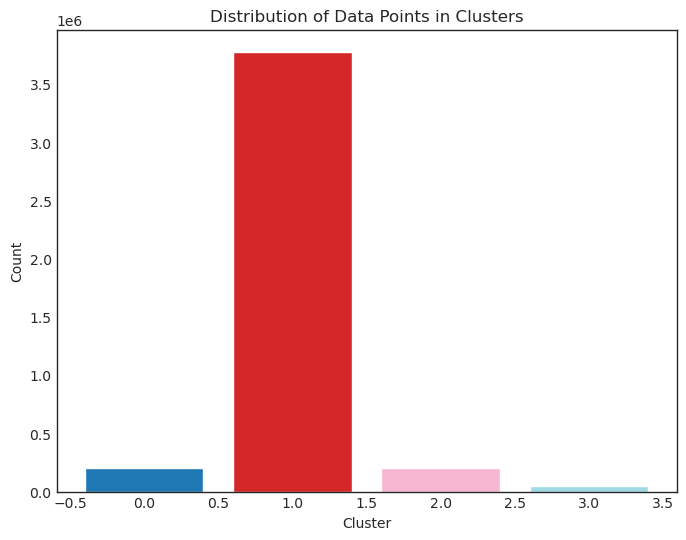

METHOD:  unweight  N_components:  16  Num Clusters:  6


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.5055437088012695


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


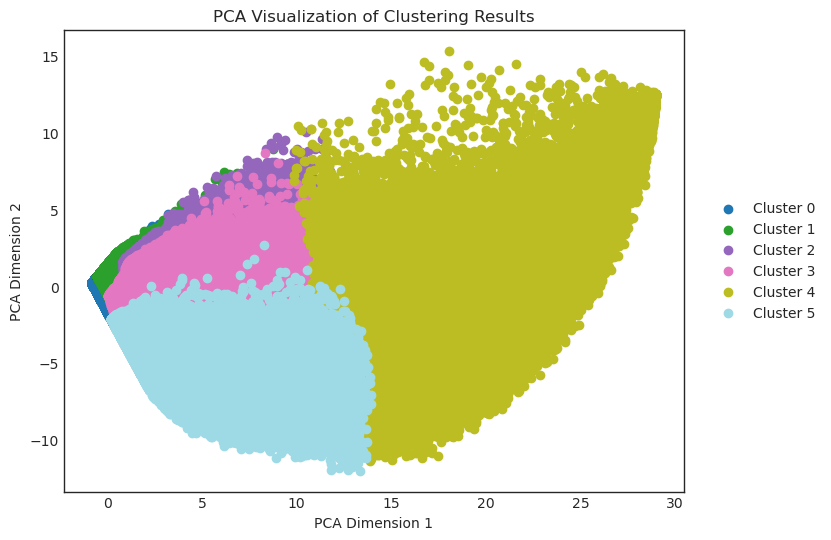

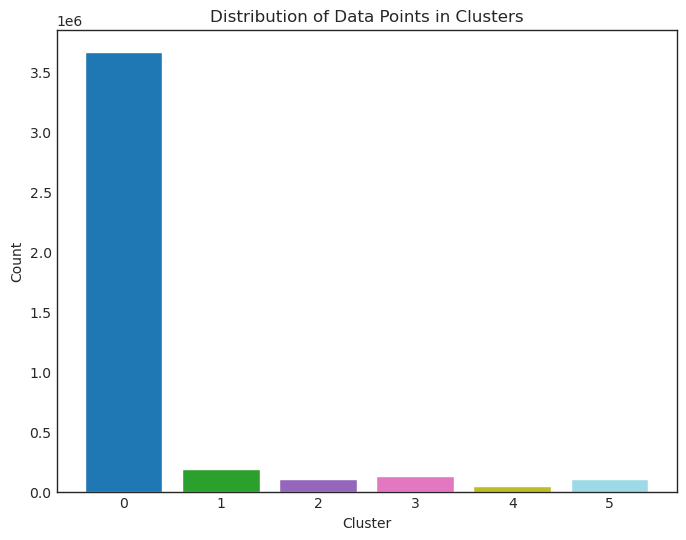

METHOD:  unweight  N_components:  16  Num Clusters:  8


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.517247438430786


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


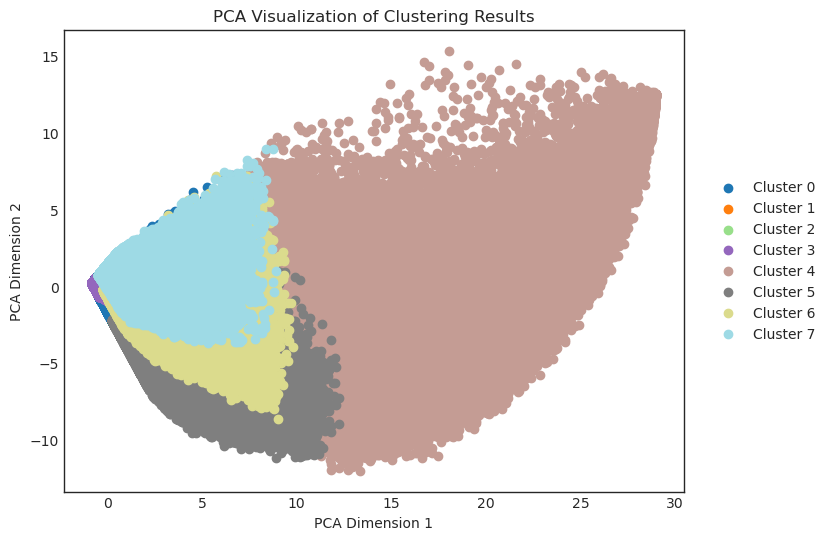

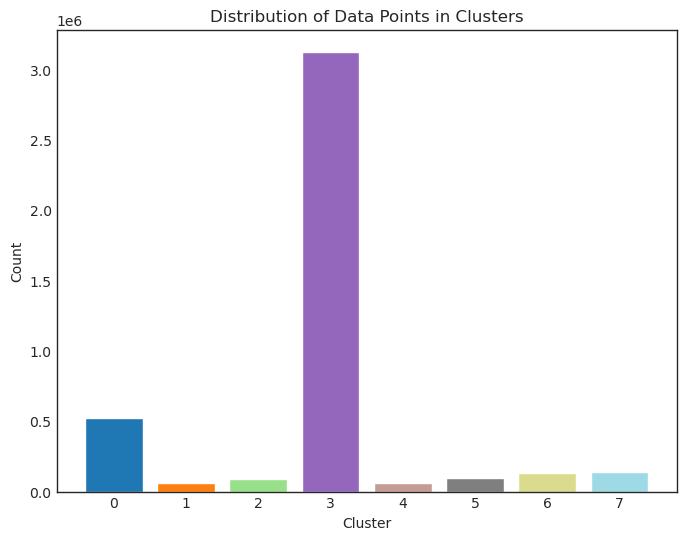

METHOD:  unweight  N_components:  16  Num Clusters:  10


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.6439554691314697


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


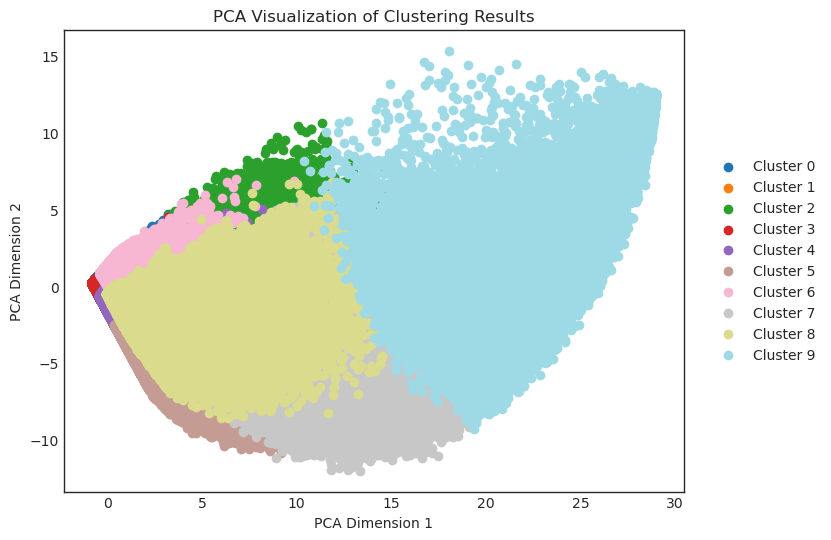

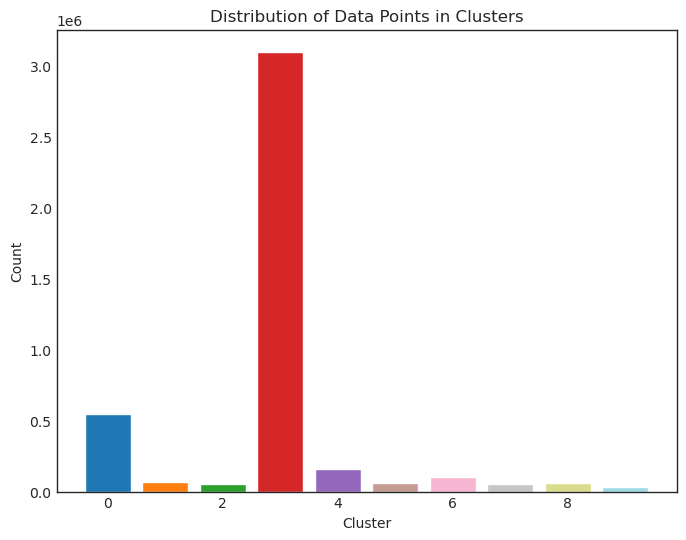

METHOD:  unweight  N_components:  16  Num Clusters:  12


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.0276248455047607


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


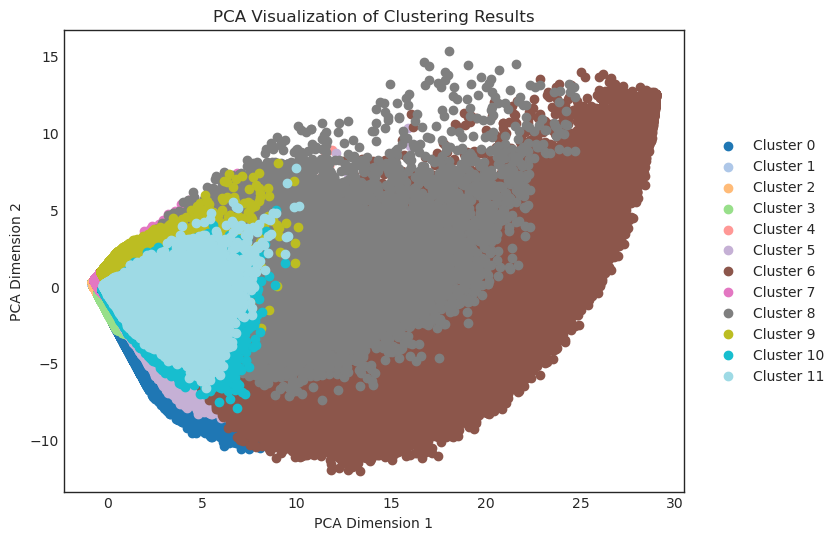

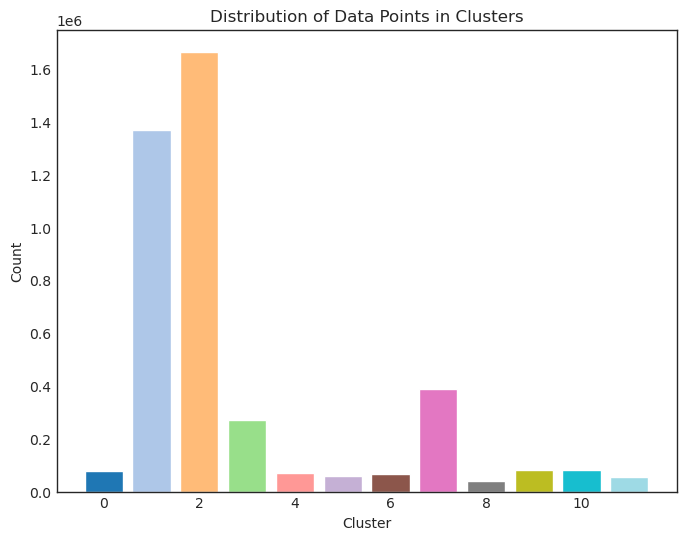

METHOD:  unweight  N_components:  16  Num Clusters:  14


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.1528406143188477


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


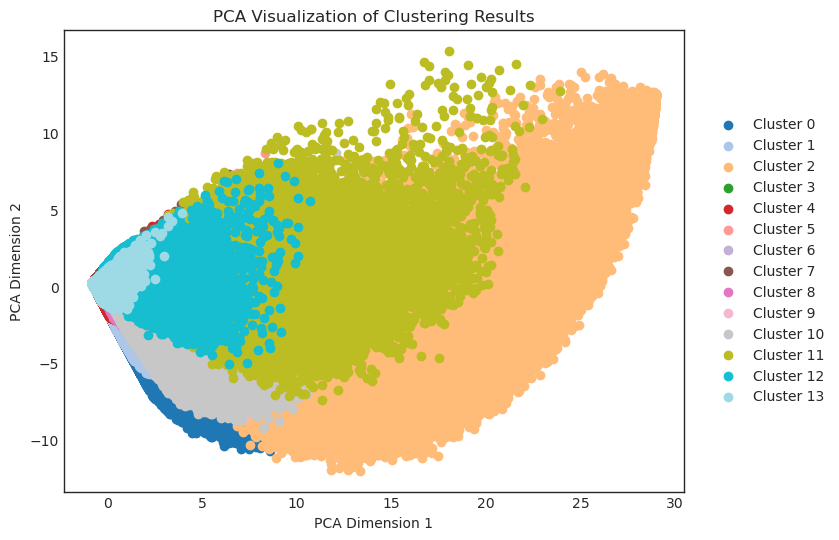

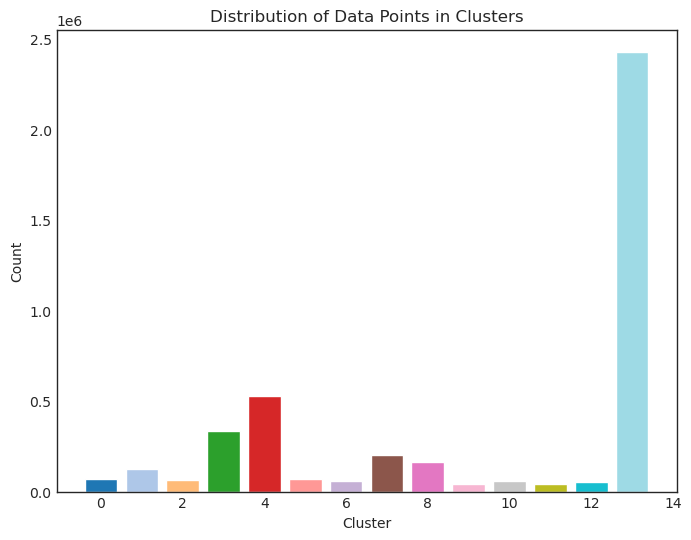

METHOD:  unweight  N_components:  16  Num Clusters:  16


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.7117695808410645


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


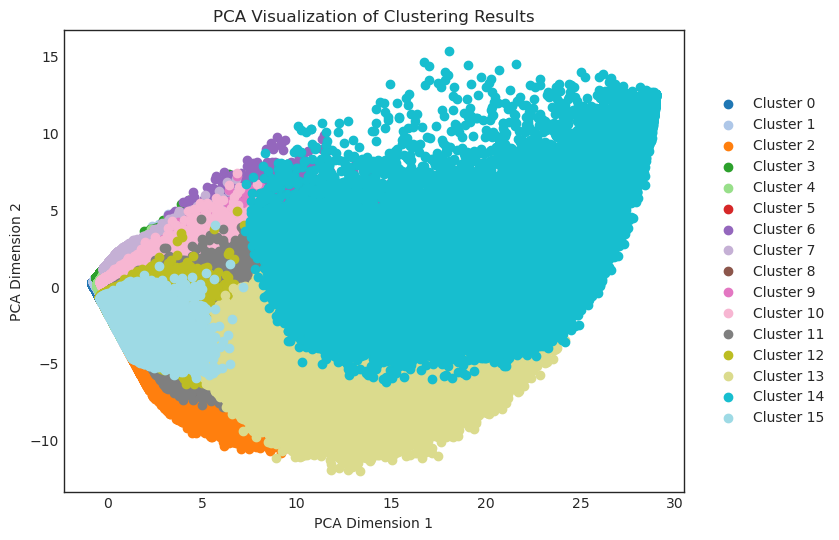

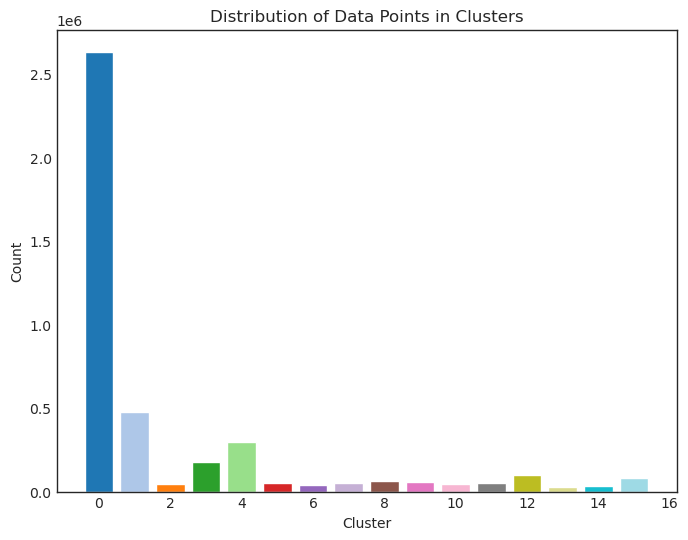

METHOD:  unweight  N_components:  16  Num Clusters:  18


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  2.6595680713653564


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


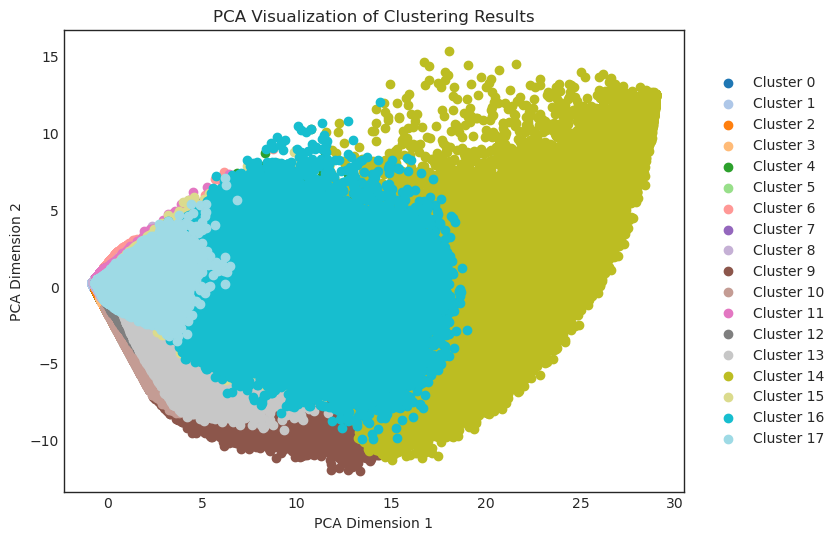

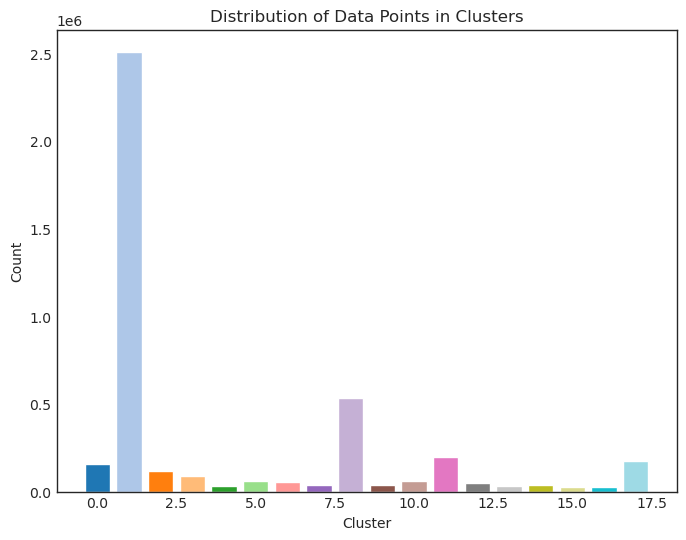

METHOD:  unweight  N_components:  16  Num Clusters:  20


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Time taken:  3.5712010860443115


/tmp/ipykernel_28129/1108890430.py:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


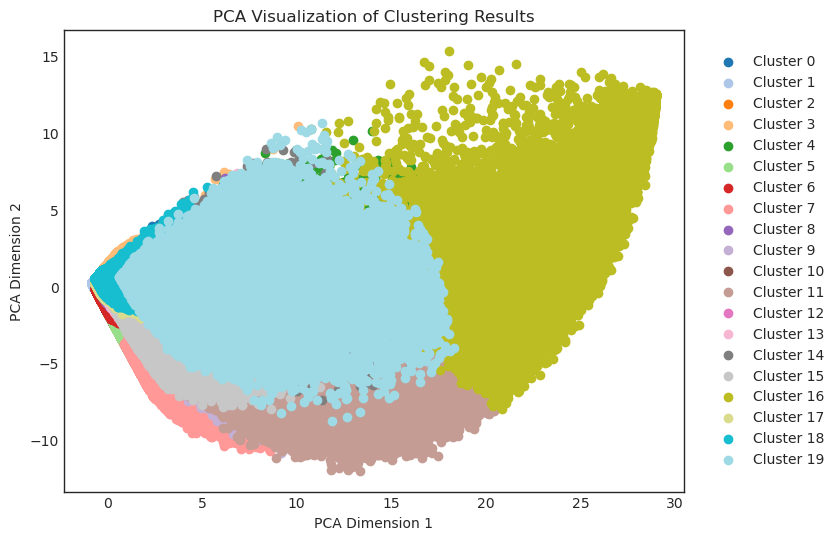

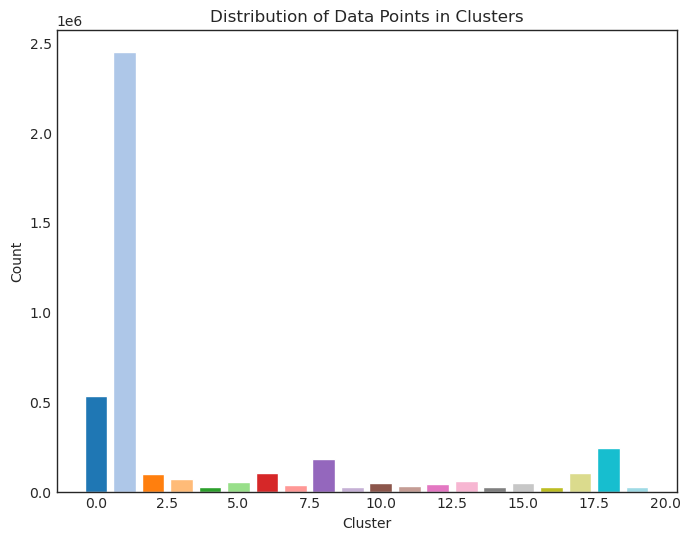

In [23]:
# again kmeans, but over range, init='k-means++'

cluster_range = range(4, 21, 2)
methods_range = ["unweight"]
NC_ar = [16]

for method in methods_range:
    for n_components in NC_ar:
        for num_clusters in cluster_range:
            start_time = time.time()
            print("METHOD: ", method, " N_components: ", n_components, " Num Clusters: ", num_clusters)

            prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

            dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

            # Normalize the data
            scaler = StandardScaler()
            dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

            # Apply MiniBatchKMeans with a varying number of clusters
            mbkmeans = MiniBatchKMeans(n_clusters=num_clusters, init='k-means++', random_state=42, batch_size=1000)
            cluster_labels = mbkmeans.fit_predict(dhs_component_matrix)

            print("Time taken: ", time.time() - start_time)
            start_time = time.time()

            # Perform dimensionality reduction using PCA
            pca = PCA(n_components=2, random_state=42)
            pca_embedding = pca.fit_transform(dhs_component_matrix)
            
            # Create a color map for the clusters
            cmap = plt.cm.get_cmap('tab20', num_clusters)

            # Visualize the results
            plt.figure(figsize=(8, 6))
            for i in range(num_clusters):
                plt.scatter(
                    pca_embedding[cluster_labels == i, 0],
                    pca_embedding[cluster_labels == i, 1],
                    color=cmap(i),
                    label=f'Cluster {i}'
                )
            plt.title('PCA Visualization of Clustering Results')
            plt.xlabel('PCA Dimension 1')
            plt.ylabel('PCA Dimension 2')
            plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
            plt.show()

            # Create a histogram of the number of dots in each cluster
            plt.figure(figsize=(8, 6))
            counts = np.bincount(cluster_labels)
            plt.bar(range(num_clusters), counts, color=cmap(range(num_clusters)))
            plt.xlabel('Cluster')
            plt.ylabel('Count')
            plt.title('Distribution of Data Points in Clusters')
            plt.show()

METHOD:  unweight  N_components:  16
Time taken:  2.2957494258880615


/tmp/ipykernel_28129/1501436377.py:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


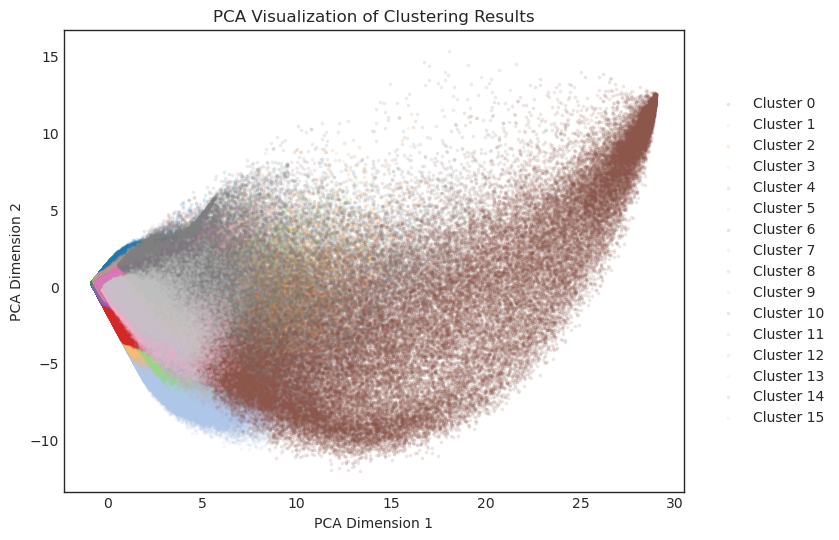

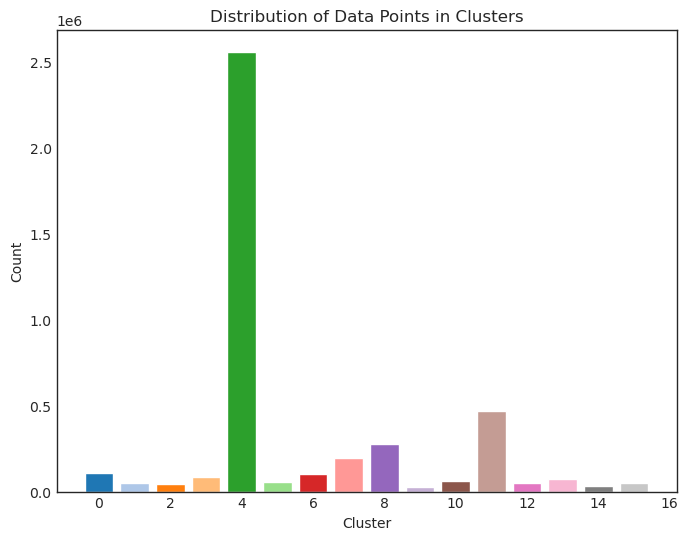

METHOD:  unweight  N_components:  16
Time taken:  2.4465978145599365


/tmp/ipykernel_28129/1501436377.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20', num_clusters)


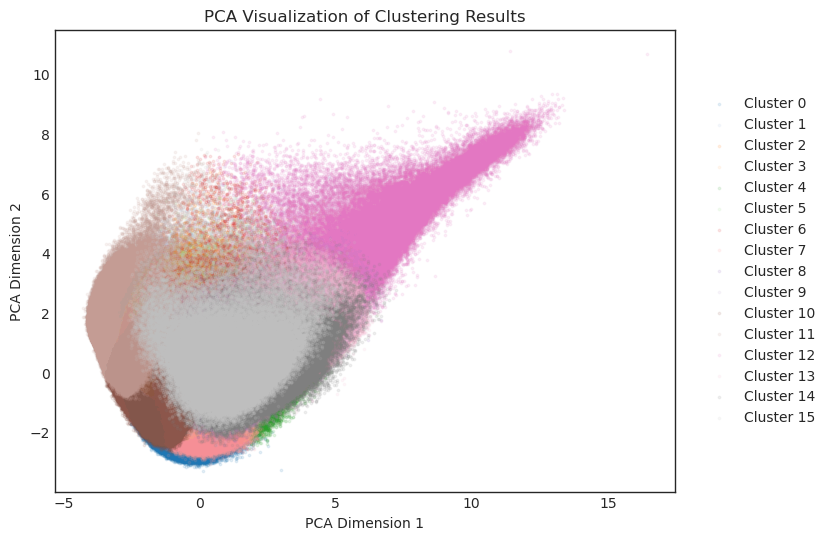

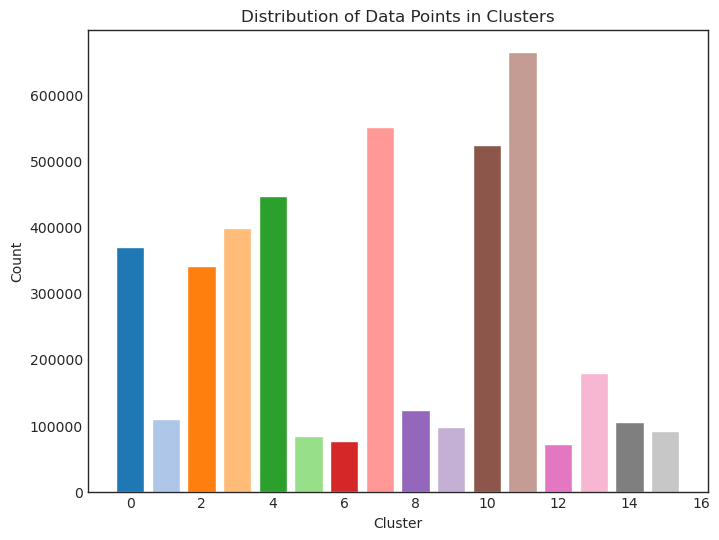

In [36]:

methods_range = ["unweight"]
NC_ar = [16]  

for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "bin_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

        # Calculate initial labels by getting the index of the maximum component for each data point
        initial_labels = np.argmax(dhs_component_matrix, axis=1)
        unique_labels, counts = np.unique(initial_labels, return_counts=True) # Get the unique labels and count the number of unique labels
        # Create initial centers based on the labels
        initial_centers = np.array([dhs_component_matrix[initial_labels == label].mean(axis=0) for label in unique_labels])

        n_clusters = len(unique_labels)
        mbkmeans = MiniBatchKMeans(n_clusters=n_clusters, init=initial_centers, random_state=42, batch_size=1000, n_init=1)
        cluster_labels = mbkmeans.fit_predict(dhs_component_matrix)

        print("Time taken: ", time.time() - start_time)
        start_time = time.time()

        # Perform dimensionality reduction using PCA
        pca = PCA(n_components=2, random_state=42)
        pca_embedding = pca.fit_transform(dhs_component_matrix)
        
        # Create a color map for the clusters
        cmap = plt.cm.get_cmap('tab20', num_clusters)
        
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                pca_embedding[cluster_labels == i, 0],
                pca_embedding[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}',
                s=3,  # the marker size
                alpha=0.1  # the transparency
            )
        plt.title('PCA Visualization of Clustering Results')
        plt.xlabel('PCA Dimension 1')
        plt.ylabel('PCA Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()
        

        # Create a histogram of the number of dots in each cluster
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels)
        plt.bar(range(n_clusters), counts, color=cmap(range(n_clusters)))
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

        '''
        # Compute the silhouette score
        silhouette = silhouette_score(dhs_component_matrix, cluster_labels)
        print(f"Silhouette score: {silhouette}")

        print("Time taken: ", time.time() - start_time)
        '''
        

methods_range = ["unweight"]
NC_ar = [16]  

for method in methods_range:
    for n_components in NC_ar:
        start_time = time.time()
        print("METHOD: ", method, " N_components: ", n_components)

        prefix = "vst_new_" + method + "_" + str(data_slice_size) + '.' + str(n_components)

        dhs_component_matrix = np.load(dir_path_pipeline + prefix + ".H.npy")

        # Normalize the data
        scaler = StandardScaler()
        dhs_component_matrix = scaler.fit_transform(dhs_component_matrix.T) 

        # Calculate initial labels by getting the index of the maximum component for each data point
        initial_labels = np.argmax(dhs_component_matrix, axis=1)
        unique_labels, counts = np.unique(initial_labels, return_counts=True) # Get the unique labels and count the number of unique labels
        # Create initial centers based on the labels
        initial_centers = np.array([dhs_component_matrix[initial_labels == label].mean(axis=0) for label in unique_labels])

        n_clusters = len(unique_labels)
        mbkmeans = MiniBatchKMeans(n_clusters=n_clusters, init=initial_centers, random_state=42, batch_size=1000, n_init=1)
        cluster_labels = mbkmeans.fit_predict(dhs_component_matrix)

        print("Time taken: ", time.time() - start_time)
        start_time = time.time()

        # Perform dimensionality reduction using PCA
        pca = PCA(n_components=2, random_state=42)
        pca_embedding = pca.fit_transform(dhs_component_matrix)
        
        # Create a color map for the clusters
        cmap = plt.cm.get_cmap('tab20', num_clusters)
        
        plt.figure(figsize=(8, 6))
        for i in range(n_clusters):
            plt.scatter(
                pca_embedding[cluster_labels == i, 0],
                pca_embedding[cluster_labels == i, 1],
                color=cmap(i),
                label=f'Cluster {i}',
                s=3,  # the marker size
                alpha=0.1  # the transparency
            )
        plt.title('PCA Visualization of Clustering Results')
        plt.xlabel('PCA Dimension 1')
        plt.ylabel('PCA Dimension 2')
        plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left", borderaxespad=0)
        plt.show()
        

        # Create a histogram of the number of dots in each cluster
        plt.figure(figsize=(8, 6))
        counts = np.bincount(cluster_labels)
        plt.bar(range(n_clusters), counts, color=cmap(range(n_clusters)))
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Data Points in Clusters')
        plt.show()

        '''
        # Compute the silhouette score
        silhouette = silhouette_score(dhs_component_matrix, cluster_labels)
        print(f"Silhouette score: {silhouette}")

        print("Time taken: ", time.time() - start_time)
        '''

# Metrics for binary matrix

In [15]:
new_bin =  np.load('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/binary.filtered.matrix.npy')

In [18]:
import pickle

method = "unweight"
NC_ar = [10,12,14,16,18,20,22,24,26]
results = {}

for n_components in NC_ar:
    print("METHOD: ", method, " N_components: ", n_components)

    prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)

    decomp = OONMF.NMFobject(n_components)
    decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                             dir_path_pipeline + prefix +'.H.npy')
    decomp.read_matrix_input(compressed=False)
    print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
      
    df = decomp.precision_recall_curve(new_bin.T)
    results[n_components] = df

with open('precision_recall_curve_results.pkl', 'wb') as f:
    pickle.dump(results, f)


METHOD:  nndsnd  N_components:  10


FileNotFoundError: [Errno 2] No such file or directory: '/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/bin_new_nndsnd_full.10.W.npy'

In [171]:
import pickle

# Load the old results
with open('precision_recall_curve_results_30.pkl', 'rb') as f:
    results = pickle.load(f)

method = "unweight"
NC_ar = [4,6,8,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,28, 30, 32, 34, 36, 38, 40, 42, 44, 46]

for n_components in NC_ar:
    # Skip calculation if results are already available
    if n_components in results:
        print(f"Results for N_components: {n_components} already available.")
        continue

    print("METHOD: ", method, " N_components: ", n_components)
    prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
    decomp = OONMF.NMFobject(n_components)
    decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                             dir_path_pipeline + prefix +'.H.npy')
    decomp.read_matrix_input(compressed=False)
    print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
      
    df = decomp.precision_recall_curve(new_bin.T)
    results[n_components] = df

# Save the updated results
with open('precision_recall_curve_results_30.pkl', 'wb') as f:
    pickle.dump(results, f)


Results for N_components: 4 already available.
Results for N_components: 6 already available.
Results for N_components: 8 already available.
Results for N_components: 10 already available.
METHOD:  unweight  N_components:  11
(3780, 11) (11, 4230461) matrixes loaded for n_components 11
Results for N_components: 12 already available.
METHOD:  unweight  N_components:  13
(3780, 13) (13, 4230461) matrixes loaded for n_components 13
Results for N_components: 14 already available.
METHOD:  unweight  N_components:  15
(3780, 15) (15, 4230461) matrixes loaded for n_components 15
Results for N_components: 16 already available.
METHOD:  unweight  N_components:  17
(3780, 17) (17, 4230461) matrixes loaded for n_components 17
Results for N_components: 18 already available.
METHOD:  unweight  N_components:  19
(3780, 19) (19, 4230461) matrixes loaded for n_components 19
Results for N_components: 20 already available.
METHOD:  unweight  N_components:  21
(3780, 21) (21, 4230461) matrixes loaded for

In [16]:
method = "nndsvd"
NC_ar = list(range(4, 41))  

results_filename = f'precision_recall_curve_results_{method}.pkl' 
if not os.path.isfile(results_filename):
    with open(results_filename, 'wb') as f:
        pickle.dump({}, f)

with open(results_filename, 'rb') as f:
    results = pickle.load(f)

missing_components = []

for n_components in NC_ar:
    # Skip calculation if results are already available
    if n_components in results:
        print(f"Results for N_components: {n_components} already available.")
        continue

    print("METHOD: ", method, " N_components: ", n_components)
    prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
    
    if not (os.path.isfile(dir_path_pipeline + prefix +'.W.npy.gz') and os.path.isfile(dir_path_pipeline + prefix +'.H.npy.gz')):
        print(f"No files found for N_components: {n_components}")
        missing_components.append(n_components)
        print(dir_path_pipeline + prefix +'.W.npy')
        continue

    decomp = OONMF.NMFobject(n_components)
    decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                             dir_path_pipeline + prefix +'.H.npy')
    decomp.read_matrix_input(compressed=True)
    print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
      
    df = decomp.precision_recall_curve(new_bin.T)
    results[n_components] = df

# Save the updated results
with open(results_filename, 'wb') as f:
    pickle.dump(results, f)

print(f"Missing N_components: {missing_components}")

METHOD:  nndsvd  N_components:  4
(3780, 4) (4, 4230461) matrixes loaded for n_components 4
METHOD:  nndsvd  N_components:  5
No files found for N_components: 5
/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/bin_new_nndsvd_full.5.W.npy
METHOD:  nndsvd  N_components:  6
(3780, 6) (6, 4230461) matrixes loaded for n_components 6
METHOD:  nndsvd  N_components:  7
No files found for N_components: 7
/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/bin_new_nndsvd_full.7.W.npy
METHOD:  nndsvd  N_components:  8
(3780, 8) (8, 4230461) matrixes loaded for n_components 8
METHOD:  nndsvd  N_components:  9
No files found for N_components: 9
/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/bin_new_nndsvd_full.9.W.npy
METHOD:  nndsvd  N_components:  10
(3780, 10) (10, 4230461) matrixes loaded for n_components 10
METHOD:  nndsvd  N_components:  11
(3780, 11) (11, 4230461) matrixes loaded for n_components 11
METHOD:  nndsvd  N_components: 

In [118]:
df[1]

,threshold,TP,FP,TN,FN
0,0.05,249805150,808028017,14909459145,23850268
1,0.10,229651858,418031317,15299455845,44003560
2,0.15,212980949,259750922,15457736240,60674469
3,0.20,198438493,174608400,15542878762,75216925
4,0.25,185235949,122139705,15595347457,88419469
5,0.30,173044099,87234597,15630252565,100611319
6,0.35,161571296,62898576,15654588586,112084122
7,0.40,150631819,45471238,15672015924,123023599
8,0.45,140094081,32805176,15684681986,133561337
9,0.50,129914907,23528437,15693958725,143740511


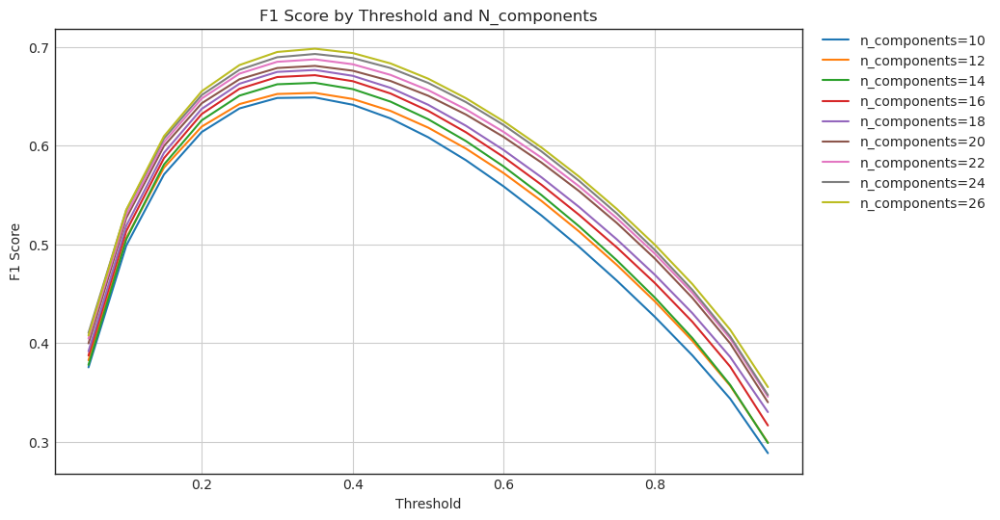

In [153]:
with open('precision_recall_curve_results.pkl', 'rb') as f:
    loaded_results = pickle.load(f)

plt.figure(figsize=(10, 6))
for n, dataframes in loaded_results.items():
    df = dataframes[1]
    df['precision'] = df['TP'] / (df['TP'] + df['FP'])
    df['recall'] = df['TP'] / (df['TP'] + df['FN'])
    df['F1'] = 2 * df['precision'] * df['recall'] / (df['precision'] + df['recall'])
    df['F1'].fillna(0, inplace=True)  # Fill NaN values with 0 (when both precision and recall are 0)
    plt.plot(df['threshold'], df['F1'], label=f'n_components={n}')

plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score by Threshold and N_components')
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.grid()
plt.show()

In [172]:
with open('precision_recall_curve_results_30.pkl', 'rb') as f:
    loaded_results = pickle.load(f)

loaded_results = dict(sorted(loaded_results.items()))

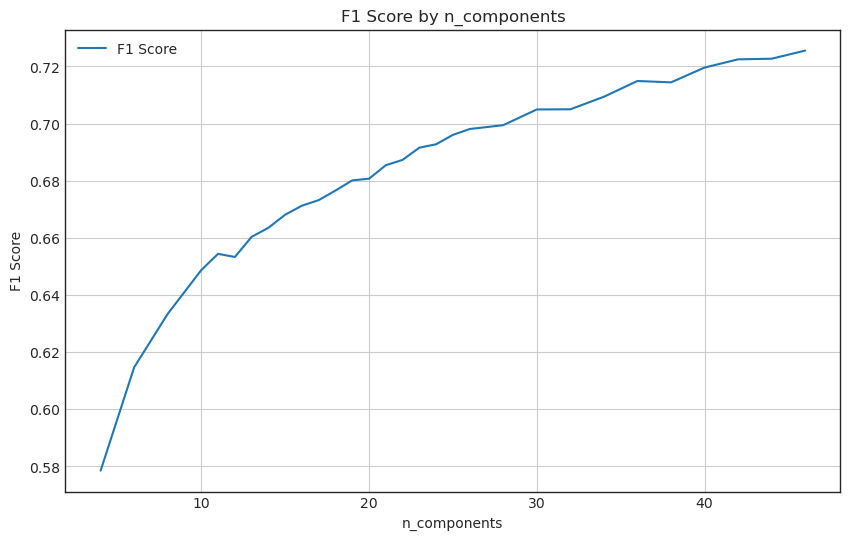

In [176]:
from sklearn.metrics import auc

n_values = []
auprc_values = []
f1_scores = []
threshold = 0.35

for n, dataframes in loaded_results.items():
    df = dataframes[1].copy()
    df = df[df['threshold'] <= threshold]  # Select rows up to the given threshold
    df['precision'] = df['TP'] / (df['TP'] + df['FP'])
    df['recall'] = df['TP'] / (df['TP'] + df['FN'])
    df['F1'] = 2 * df['precision'] * df['recall'] / (df['precision'] + df['recall'])
    df['F1'].fillna(0, inplace=True)  # Fill NaN values with 0 (when both precision and recall are 0)
    f1_score = df.loc[df['threshold'] == threshold, 'F1'].values[0]  # F1 score at the given threshold

    n_values.append(n)
    f1_scores.append(f1_score)


plt.figure(figsize=(10, 6))
plt.plot(n_values, f1_scores, label='F1 Score')
plt.xlabel('n_components')
plt.ylabel('F1 Score')
plt.title('F1 Score by n_components')
plt.legend()
plt.grid()
plt.show()



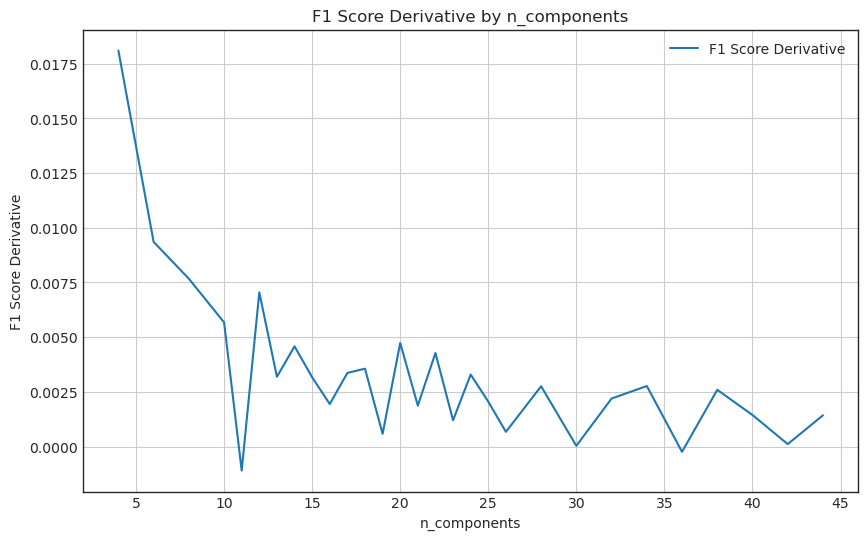

In [174]:
n_values = []
auprc_values = []
f1_scores = []
threshold = 0.35

for n, dataframes in loaded_results.items():
    df = dataframes[1].copy()
    df = df[df['threshold'] <= threshold]  # Select rows up to the given threshold
    df['precision'] = df['TP'] / (df['TP'] + df['FP'])
    df['recall'] = df['TP'] / (df['TP'] + df['FN'])
    df['F1'] = 2 * df['precision'] * df['recall'] / (df['precision'] + df['recall'])
    df['F1'].fillna(0, inplace=True)  # Fill NaN values with 0 (when both precision and recall are 0)
    f1_score = df.loc[df['threshold'] == threshold, 'F1'].values[0]  # F1 score at the given threshold

    n_values.append(n)
    f1_scores.append(f1_score)

f1_derivatives = np.diff(f1_scores) / np.diff(n_values)

plt.figure(figsize=(10, 6))
plt.plot(n_values[:-1], f1_derivatives, label='F1 Score Derivative')
plt.xlabel('n_components')
plt.ylabel('F1 Score Derivative')
plt.title('F1 Score Derivative by n_components')
plt.legend()
plt.grid()
plt.show()


In [183]:
from scipy.interpolate import UnivariateSpline

n_values = np.array(n_values)
f1_scores = np.array(f1_scores)
spl = UnivariateSpline(n_values, f1_scores)
spl.set_smoothing_factor(0.3)  # adjust this
smoothed_f1_scores = spl(n_values)
smoothed_f1_derivatives = np.diff(smoothed_f1_scores) / np.diff(n_values)


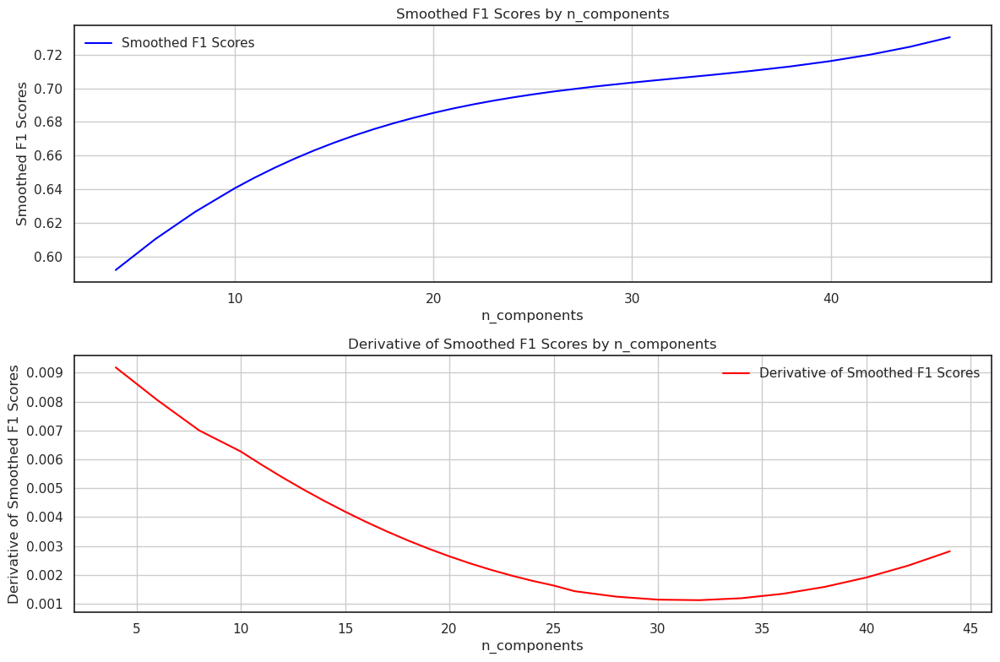

In [184]:
sns.set_theme()  
sns.set_style("white")
plt.figure(figsize=(12, 8))

# Plot for smoothed F1 score
plt.subplot(2, 1, 1)
plt.plot(n_values, smoothed_f1_scores, label='Smoothed F1 Scores', color='blue')
plt.xlabel('n_components')
plt.ylabel('Smoothed F1 Scores')
plt.title('Smoothed F1 Scores by n_components')
plt.legend()
plt.grid()

# Plot for the derivative of the smoothed F1 score
plt.subplot(2, 1, 2)
plt.plot(n_values[:-1], smoothed_f1_derivatives, label='Derivative of Smoothed F1 Scores', color='red')
plt.xlabel('n_components')
plt.ylabel('Derivative of Smoothed F1 Scores')
plt.title('Derivative of Smoothed F1 Scores by n_components')
plt.legend()
plt.grid()

plt.tight_layout()  # This will make sure the plots do not overlap
plt.show()

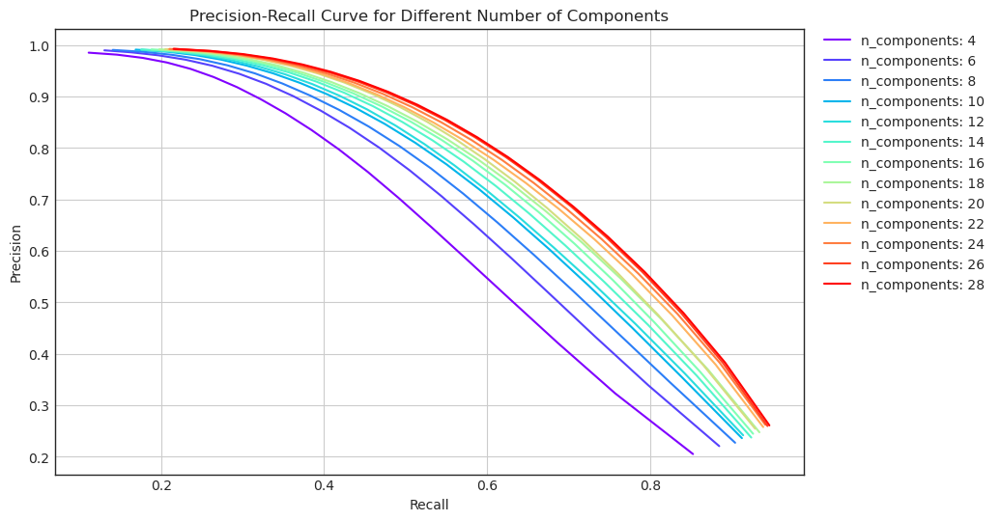

In [167]:
colors = cm.rainbow(np.linspace(0, 1, len(loaded_results)))
plt.figure(figsize=(10, 6))

# For each number of components, calculate and plot PRC
for (n, dataframes), color in zip(loaded_results.items(), colors):
    df = dataframes[1].copy()
    
    df['precision'] = df['TP'] / (df['TP'] + df['FP'])
    df['recall'] = df['TP'] / (df['TP'] + df['FN'])

    precision_values = df['precision'].values
    recall_values = df['recall'].values

    plt.plot(recall_values, precision_values, color=color, label=f'n_components: {n}')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve for Different Number of Components')
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.grid()
plt.show()

In [140]:
precision_values

array([0.25978472, 0.38233011, 0.47875641, 0.55898549, 0.62747179,
       0.68670965, 0.73807054, 0.78265786, 0.82140885, 0.85500894,
       0.88398939, 0.90873115, 0.92973892, 0.94728611, 0.96166328,
       0.97314963, 0.98195532, 0.98834961, 0.99259188])

In [136]:
threshold= 0.35
for n, dataframes in loaded_results.items():
    df = dataframes[1].copy()
    print(df[df['threshold'] == threshold])

   threshold         TP        FP           TN         FN  precision  \
6       0.35  161571296  62898576  15654588586  112084122   0.719791   

     recall        F1  
6  0.590419  0.648717  
   threshold         TP        FP           TN         FN  precision  \
6       0.35  163766112  63936573  15653550589  109889306    0.71921   

     recall       F1  
6  0.598439  0.65329  
   threshold         TP        FP           TN         FN  precision  \
6       0.35  167061988  62845513  15654641649  106593430   0.726649   

     recall       F1  
6  0.610483  0.66352  
   threshold         TP        FP           TN         FN  precision  \
6       0.35  170214003  63278678  15654208484  103441415   0.728991   

     recall       F1  
6  0.622001  0.67126  
   threshold         TP        FP           TN         FN  precision  \
6       0.35  172559493  63892946  15653594216  101095925   0.729785   

     recall        F1  
6  0.630572  0.676561  
   threshold         TP        FP        

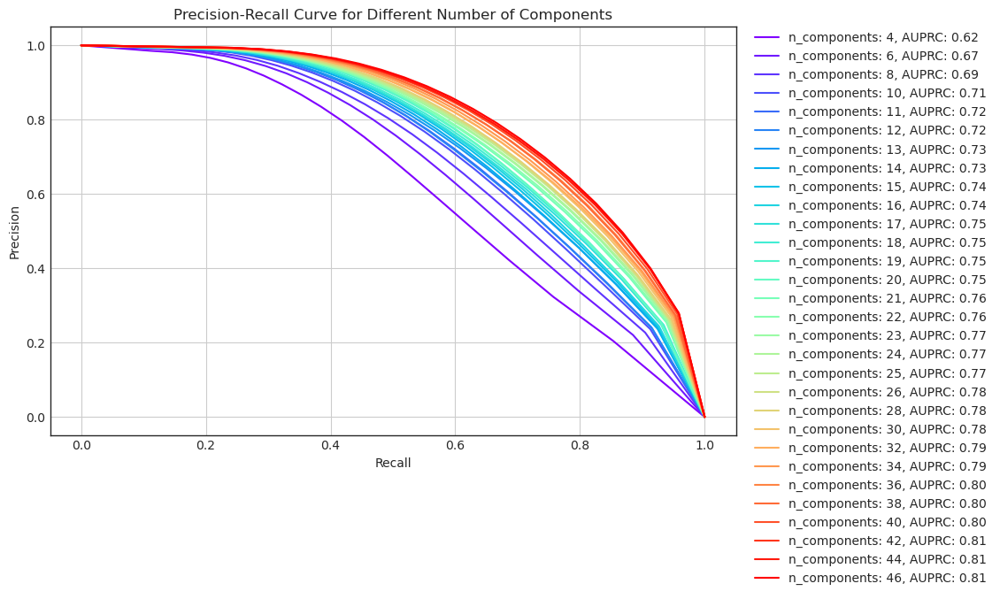

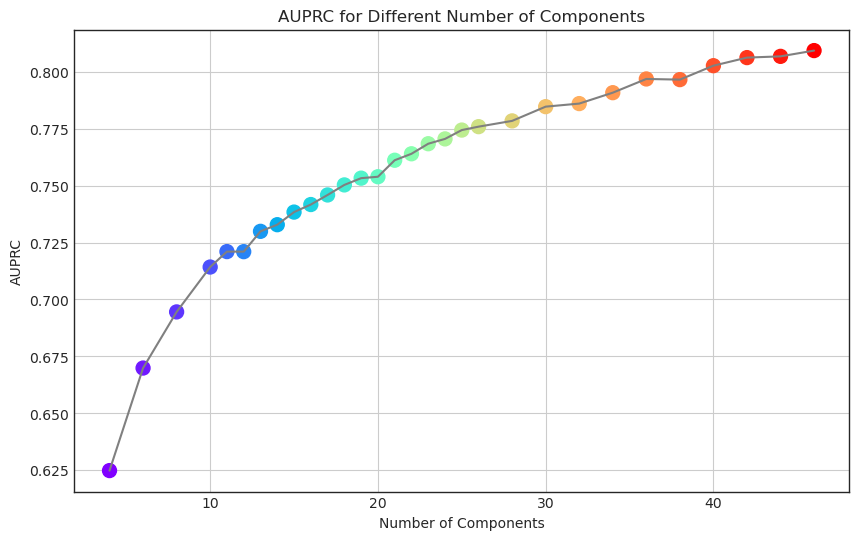

In [175]:
# Create a color map
colors = cm.rainbow(np.linspace(0, 1, len(loaded_results)))

plt.figure(figsize=(10, 6))

# Container for AUC scores
auprc_scores = []

# For each number of components, calculate and plot PRC
for (n, dataframes), color in zip(loaded_results.items(), colors):
    df = dataframes[1].copy()
    
    df['precision'] = df['TP'] / (df['TP'] + df['FP'])
    df['recall'] = df['TP'] / (df['TP'] + df['FN'])

    precision_values = df['precision'].values
    recall_values = df['recall'].values

    # Add points (0, 1) and (1, 0)
    precision_values = np.insert(precision_values, 0, 1)
    recall_values = np.insert(recall_values, 0, 0)
    precision_values = np.append(precision_values, 0)
    recall_values = np.append(recall_values, 1)

    # Sort recall and corresponding precision values in ascending order
    sort_indices = np.argsort(recall_values)
    recall_values = recall_values[sort_indices]
    precision_values = precision_values[sort_indices]

    # Calculate area under the curve
    area = auc(recall_values, precision_values)
    auprc_scores.append((n, area))
    
    plt.plot(recall_values, precision_values, color=color, label=f'n_components: {n}, AUPRC: {area:.2f}')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve for Different Number of Components')
plt.legend(loc='upper left', bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.grid()
plt.show()

# Plotting AUPRC scores
n_components, scores = zip(*auprc_scores)

plt.figure(figsize=(10, 6))
plt.scatter(n_components, scores, c=colors, s=100)
plt.plot(n_components, scores, linestyle='-', color='grey')
plt.xlabel('Number of Components')
plt.ylabel('AUPRC')
plt.title('AUPRC for Different Number of Components')
plt.grid()
plt.show()


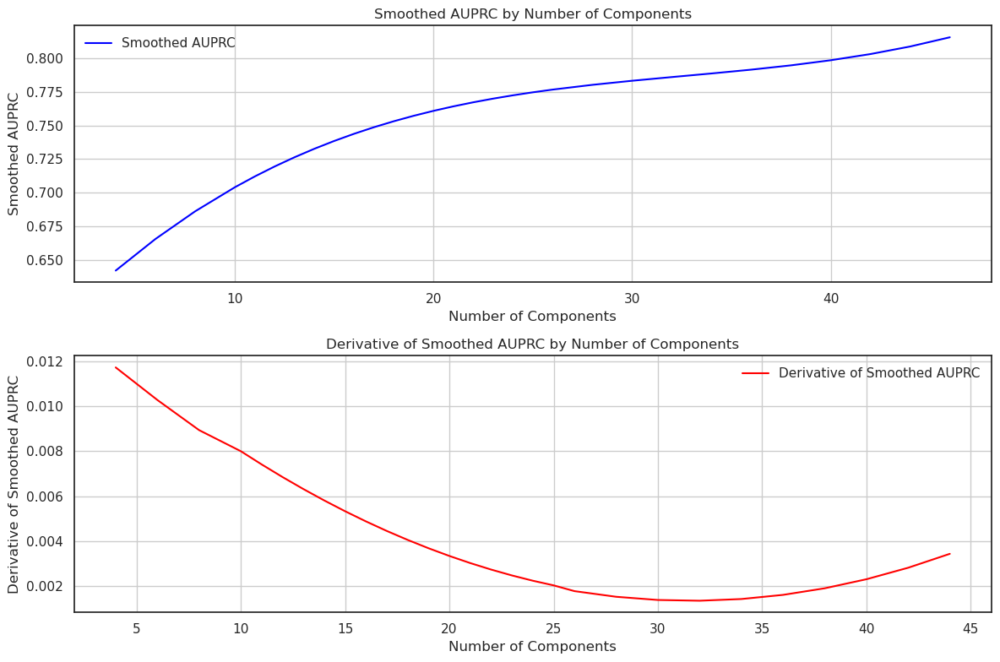

In [185]:
n_components = np.array(n_components)
scores = np.array(scores)

# Create a Univariate Spline
spl = UnivariateSpline(n_components, scores)
spl.set_smoothing_factor(0.5)
smoothed_scores = spl(n_components)
scores_derivative = np.diff(smoothed_scores) / np.diff(n_components)

sns.set_theme()
sns.set_style("white")

plt.figure(figsize=(12, 8))

# Plot for smoothed AUPRC scores
plt.subplot(2, 1, 1)
plt.plot(n_components, smoothed_scores, label='Smoothed AUPRC', color='blue')
plt.xlabel('Number of Components')
plt.ylabel('Smoothed AUPRC')
plt.title('Smoothed AUPRC by Number of Components')
plt.legend()
plt.grid()

# Plot for the derivative of the smoothed AUPRC
plt.subplot(2, 1, 2)
plt.plot(n_components[:-1], scores_derivative, label='Derivative of Smoothed AUPRC', color='red')
plt.xlabel('Number of Components')
plt.ylabel('Derivative of Smoothed AUPRC')
plt.title('Derivative of Smoothed AUPRC by Number of Components')
plt.legend()
plt.grid()

plt.tight_layout()  # This will ensure the subplots do not overlap
plt.show()


# Recalculating NMF with NNDSVD initialization

In [16]:
new_bin.T.shape

(3780, 4230461)

In [191]:
test = new_bin.T[:50]
test.shape

(50, 4230461)

In [17]:
method = "nndsvd"
NC_ar = [15,17,19,21,23,25,27,29,31,33,35,40]
seed = 20 # (not very important for NNDSVD)
data_slice_size = "full"

for n_components in NC_ar:
    start_time = time.time()
    print("METHOD: ", method, " N_components: ", n_components)
    prefix = "bin_new_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
    
    decomp = OONMF.NMFobject(n_components)
    decomp.performNMF(data=new_bin.T, randomseed=seed, theinit='nndsvd')
    decomp.writeNMF(Basis_foutname= dir_path_pipeline + prefix +'.W.npy', Mixture_foutname=dir_path_pipeline + prefix +'.H.npy')

    end_time = time.time()
    print("Time taken by fitting:", end_time - start_time, "seconds, n_components", n_components)

    
    

METHOD:  nndsvd  N_components:  15
starting NMF at  20230727_21:32:19


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230727_22:18:26
returning reconstruction error
Time taken by fitting: 2839.2623488903046 seconds, n_components 15
METHOD:  nndsvd  N_components:  17
starting NMF at  20230727_22:19:38


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230727_23:01:22
returning reconstruction error
Time taken by fitting: 2583.5314099788666 seconds, n_components 17
METHOD:  nndsvd  N_components:  19
starting NMF at  20230727_23:02:42


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230727_23:54:20
returning reconstruction error
Time taken by fitting: 3184.915624141693 seconds, n_components 19
METHOD:  nndsvd  N_components:  21
starting NMF at  20230727_23:55:46
done with NMF at  20230728_00:48:50
returning reconstruction error
Time taken by fitting: 3278.51087141037 seconds, n_components 21
METHOD:  nndsvd  N_components:  23
starting NMF at  20230728_00:50:25


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_01:47:30
returning reconstruction error
Time taken by fitting: 3525.661333322525 seconds, n_components 23
METHOD:  nndsvd  N_components:  25
starting NMF at  20230728_01:49:11


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_02:42:03
returning reconstruction error
Time taken by fitting: 3275.991504907608 seconds, n_components 25
METHOD:  nndsvd  N_components:  27
starting NMF at  20230728_02:43:47


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_03:44:11
returning reconstruction error
Time taken by fitting: 3732.376710176468 seconds, n_components 27
METHOD:  nndsvd  N_components:  29
starting NMF at  20230728_03:45:59


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_04:56:24
returning reconstruction error
Time taken by fitting: 4337.855053424835 seconds, n_components 29
METHOD:  nndsvd  N_components:  31
starting NMF at  20230728_04:58:17


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_06:18:59
returning reconstruction error
Time taken by fitting: 4957.8105137348175 seconds, n_components 31
METHOD:  nndsvd  N_components:  33
starting NMF at  20230728_06:20:55


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_07:43:29
returning reconstruction error
Time taken by fitting: 5075.404907941818 seconds, n_components 33
METHOD:  nndsvd  N_components:  35
starting NMF at  20230728_07:45:30


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_09:08:36
returning reconstruction error
Time taken by fitting: 5116.521652460098 seconds, n_components 35
METHOD:  nndsvd  N_components:  40
starting NMF at  20230728_09:10:47


/home/aabisheva/anaconda3/envs/nmf/lib/python3.11/site-packages/sklearn/decomposition/_nmf.py:1665: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


done with NMF at  20230728_10:34:56
returning reconstruction error
Time taken by fitting: 5194.718309402466 seconds, n_components 40


# DHS annotation

In [ ]:
dhs_bed_file = '/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/masterlist.filtered.bed'
dhs_regions = pd.read_csv(dhs_bed_file, sep='\t')
dhs_regions

# Removing some samples

In [90]:
with open('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/high_coverage_unresolved_datasets.txt', 'r') as file:
    samples_list = [line.strip() for line in file]
samples_count = len(samples_list)
print(f'There are {samples_count} samples in the list.')

# Check if all samples are present in the dataframe
samples_present = metadata['id'].isin(samples_list).sum()
print(f'{samples_present} out of {samples_count} samples are present in the dataframe.')

if samples_present == samples_count:
    print('All samples are present in the dataframe.')
else:
    missing_samples = set(samples_list) - set(metadata['id'].tolist())
    print(f'Missing samples: {", ".join(missing_samples)}')

There are 328 samples in the list.
328 out of 328 samples are present in the dataframe.
All samples are present in the dataframe.


In [106]:
# Remove these indices (rows) from the new_bin matrix
indices_to_remove = metadata[metadata['id'].isin(samples_list)].index.tolist()
filtered_matrix = np.delete(new_bin, indices_to_remove, axis=1)
output_path = '/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/binary.filtered.matrix.modified.npy'
np.save(output_path, filtered_matrix)

print(f"Filtered matrix saved to {output_path}")

Filtered matrix saved to /net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/binary.filtered.matrix.modified.npy


In [107]:
new_bin.shape

(4230461, 3780)

In [108]:
filtered_matrix.shape

(4230461, 3452)

In [110]:
filtered_allnames = [name for idx, name in enumerate(allnames) if idx not in indices_to_remove]

METHOD:  unweight  N_components:  16
(3452, 16) (16, 4230461) matrixes loaded for n_components 16


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:160: RuntimeWarning: invalid value encountered in divide
  self.NormedMixture =   self.Mixture / np.sum(self.Mixture, axis=0)


<Figure size 640x480 with 0 Axes>

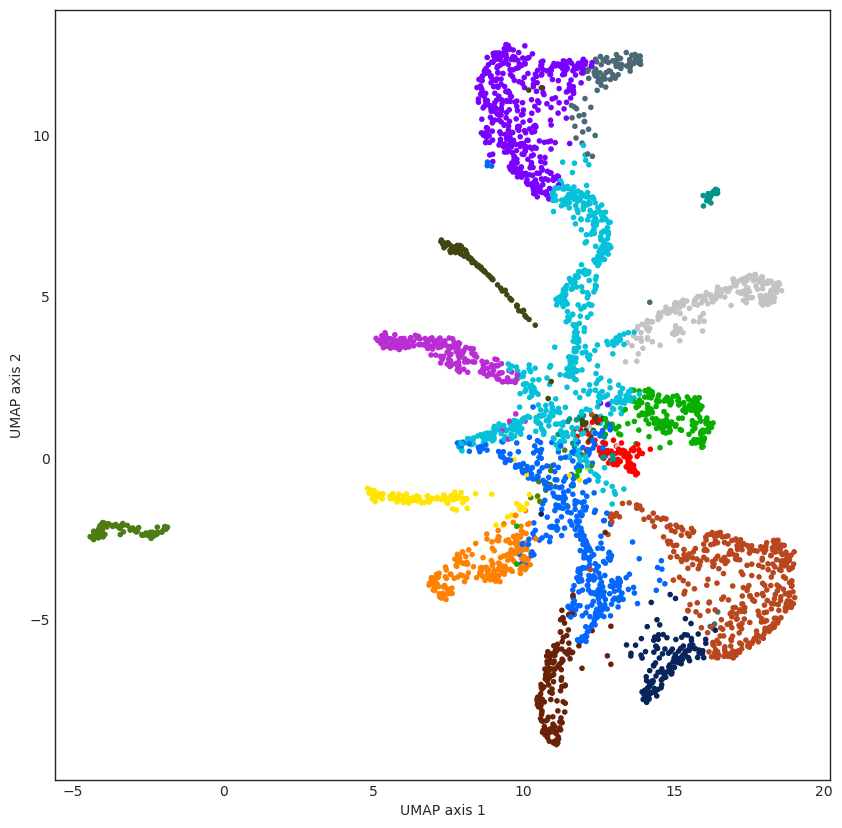

METHOD:  unweight  N_components:  24
(3452, 24) (24, 4230461) matrixes loaded for n_components 24


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:160: RuntimeWarning: invalid value encountered in divide
  self.NormedMixture =   self.Mixture / np.sum(self.Mixture, axis=0)


<Figure size 640x480 with 0 Axes>

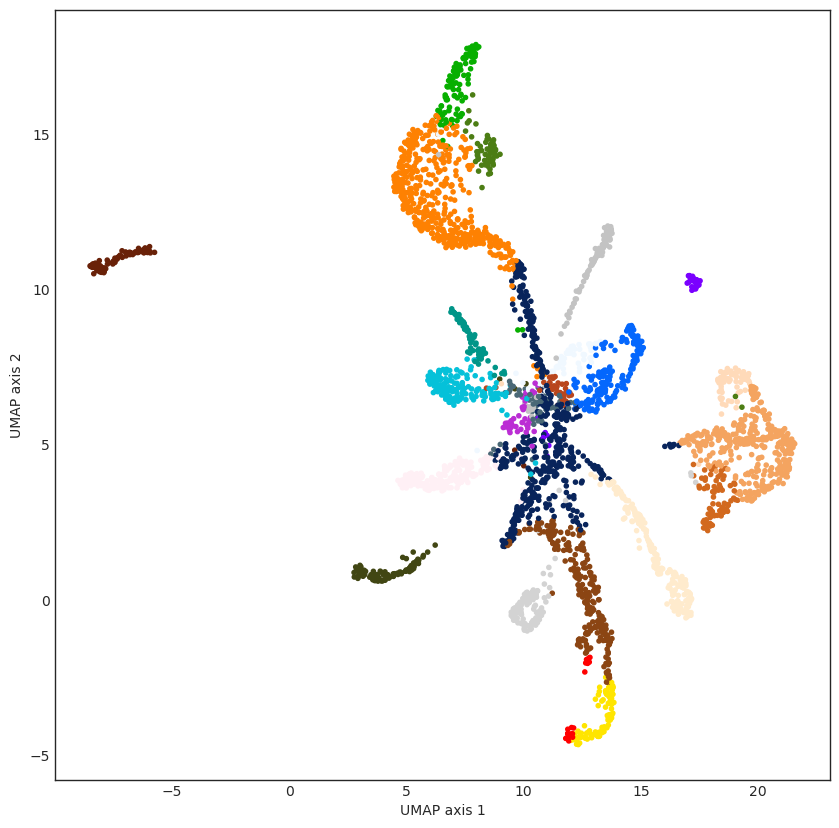

In [145]:
methods_range = ["unweight"]
NC_ar = [16, 24]
data_slice_size = "full"


for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_modified_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.NormedBasis)
        decomp.define_colors()
        
        # Normolized stacked barplot
        decomp.make_continuous_stacked_bar_plot_sorted(decomp.NormedBasis.shape[0], 
                         decomp.NormedBasis.T, 
                         dir_path_figures + prefix + '.stacked_bar_plot.normed.pdf', 
                         names=np.array(filtered_allnames), 
                         barsortorder=bar_graph_sort_order)
        
        
        # UMAP 
        majcomp = np.argmax(decomp.Basis, axis=1)
        majcomp_no1 = np.argmax(decomp.Basis[:,1:], axis=1)+1
        
        reducer = umap.UMAP(min_dist=0.5, n_neighbors=200, random_state=20)
        embedding = reducer.fit_transform(decomp.Basis)

        plt.clf()
        plt.figure(figsize=(10,10))
        decomp.define_colors()
        plt.scatter(embedding[:,0], embedding[:,1], color=np.array(decomp.Comp_colors)[majcomp], alpha=1, marker='.')
        plt.ylabel('UMAP axis 2')
        plt.xlabel('UMAP axis 1')
        plt.savefig(dir_path_figures + prefix + '.umap.pdf', )
        plt.show()
        
        


METHOD:  unweight  N_components:  16
(3452, 16) (16, 4230461) matrixes loaded for n_components 16


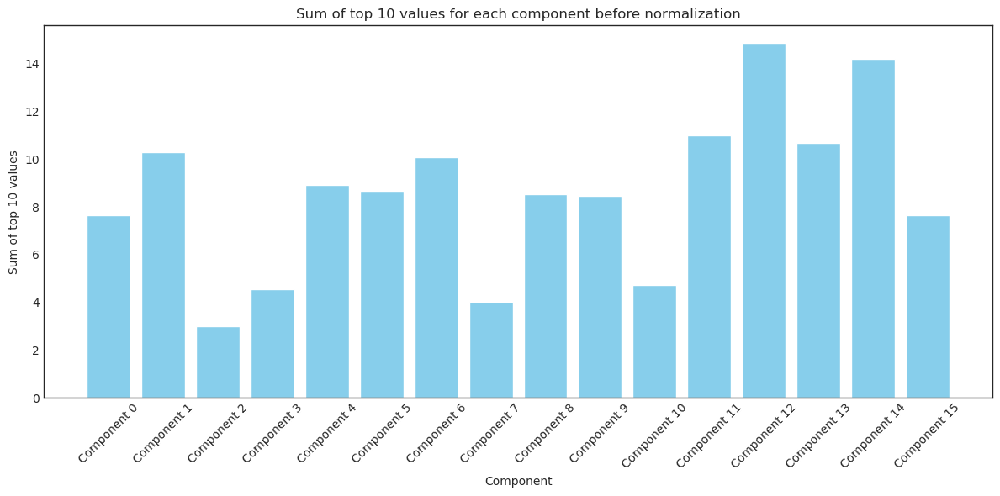

Number of samples in this category  203
['h.K562' 'h.K562' 'h.K562' 'h.K562' 'h.K562' 'h.K562' 'h.K562' 'h.K562'
 'h.K562' 'h.K562']
Number of samples in this category  203
['h.NCI-H2081' 'h.NCI-H510A' 'h.NCI-H2029' 'h.NCI-H2029' 'h.NCI-H510A'
 'h.NCI-H510A' 'h.NCI-H2029' 'h.NCI-H2029' 'h.NCI-H2029' 'h.NCI-H2029']
Number of samples in this category  580
['h.brain.anterior.cingulate.cortex' 'h.heart'
 'h.brain.anterior.cingulate.cortex' 'h.brain.amygdala'
 'h.brain.hippocampus' 'h.brain.anterior.cingulate.cortex'
 'h.brain.amygdala' 'h.brain.hypothalamus' 'h.brain.substantia.nigra'
 'h.brain.spinal.cord']
Number of samples in this category  438
['h.brain.amygdala' 'h.brain.amygdala' 'h.brain.hippocampus'
 'h.brain.hypothalamus' 'h.brain.hypothalamus' 'h.brain.nucleus.accumbens'
 'h.brain.hypothalamus' 'h.brain.amygdala' 'h.brain.hippocampus'
 'h.brain.hippocampus']
Number of samples in this category  194
['LHCN-M2' 'fSkin Fibroblast' 'HIPEpiC' 'fSkin Fibroblast' 'NHLF'
 'fSkin Fibroblas

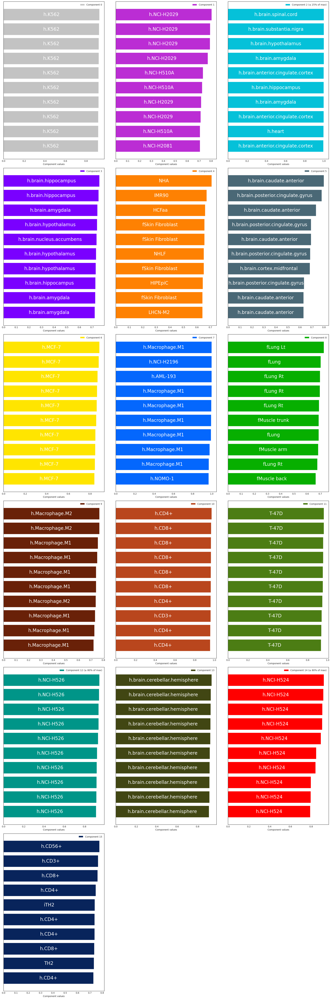

METHOD:  unweight  N_components:  24
(3452, 24) (24, 4230461) matrixes loaded for n_components 24


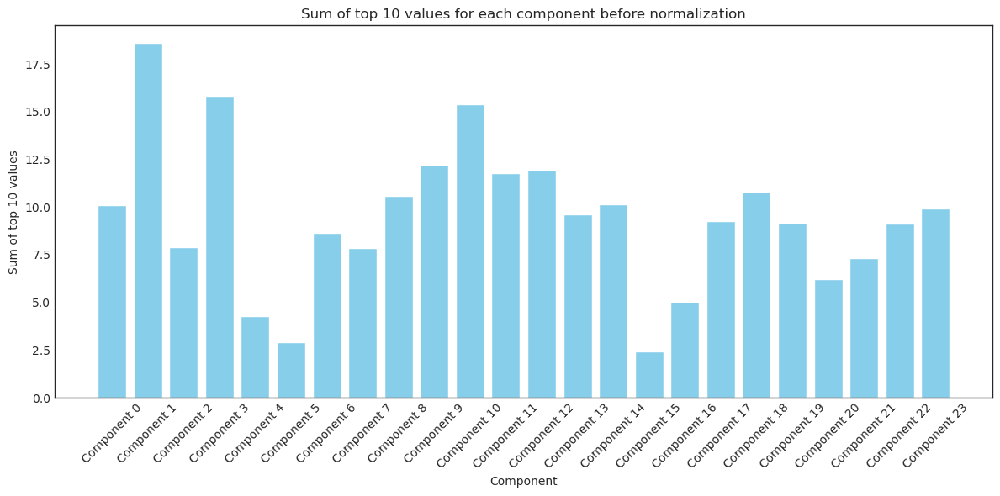

Number of samples in this category  98
['h.brain.cerebellar.hemisphere' 'h.brain.cerebellar.hemisphere'
 'h.brain.cerebellar.hemisphere' 'h.brain.cerebellar.hemisphere'
 'h.brain.cerebellar.hemisphere' 'h.brain.cerebellar.hemisphere'
 'h.brain.cerebellar.hemisphere' 'h.brain.cerebellar.hemisphere'
 'h.brain.cerebellar.hemisphere' 'h.brain.cerebellar.hemisphere']
Number of samples in this category  45
['h.NCI-H524' 'h.NCI-H524' 'h.NCI-H524' 'h.NCI-H524' 'h.NCI-H524'
 'h.NCI-H524' 'h.NCI-H524' 'h.NCI-H524' 'h.NCI-H524' 'h.NCI-H524']
Number of samples in this category  157
['GM04503D' 'h.BMEC' 'IMR90' 'NHA' 'AG04449' 'NHLF' 'HNPCEpiC' 'AG04449'
 'GM04503D' 'HNPCEpiC']
Number of samples in this category  36
['h.NCI-H526' 'h.NCI-H526' 'h.NCI-H526' 'h.NCI-H526' 'h.NCI-H526'
 'h.NCI-H526' 'h.NCI-H526' 'h.NCI-H526' 'h.NCI-H526' 'h.NCI-H526']
Number of samples in this category  492
['h.brain.nucleus.accumbens' 'h.brain.hippocampus'
 'h.brain.anterior.cingulate.cortex' 'h.brain.anterior.cingulat

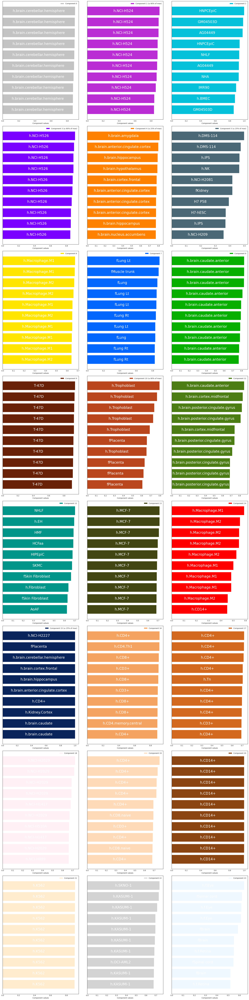

In [119]:
methods_range = ["unweight"]
NC_ar = [16, 24]
data_slice_size = "full"

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        prefix = "bin_modified_" + method + "_" + str(data_slice_size)+'.'+ str(n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_pipeline + prefix +'.W.npy', 
                                 dir_path_pipeline + prefix +'.H.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        # Just plot of Sum of top 10 values for each component before normalization
        sum_top10_values = []
        for i_component in range(n_components):
            component_values = decomp.Basis[:, i_component]
            top_values = np.sort(component_values)[-10:]
            sum_top10 = np.sum(top_values)
            sum_top10_values.append(sum_top10)

        # Plotting
        plt.figure(figsize=(12, 6))
        plt.bar(np.arange(n_components), sum_top10_values, color='skyblue')
        plt.xlabel('Component')
        plt.ylabel('Sum of top 10 values')
        plt.title('Sum of top 10 values for each component before normalization')
        plt.xticks(np.arange(n_components), [f'Component {i}' for i in range(n_components)], rotation=45)
        plt.tight_layout()
        plt.savefig(dir_path_figures+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.sum_top10.before_normalization.png', bbox_inches='tight')
        plt.show()        
        # Calculate thresholds based on the sum of top 10 values
        low_threshold = 0.25 * max(sum_top10_values)
        high_threshold = 0.80 * max(sum_top10_values)
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.define_colors()
        

        ### Interpretation part
        # Determine the number of rows and columns for the subplots
        ncols = 3
        nrows = int(np.ceil(n_components / ncols))

        # Create a figure with subplots
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 10 * nrows))
        axes = axes.flatten()  # Flatten the axes array to easily loop through

        for i_component in range(n_components):
            # Plot i_component major
            green_cut = np.argmax(decomp.Basis, axis=1) == i_component
            print("Number of samples in this category ", len(green_cut[green_cut]))

            if len(green_cut[green_cut]) >= 10:  # if not, there are too few samples to count 10% top
                # Plot top 10% of this major as described:
                colors = colors_order
                decomp_NormedBasis = decomp.NormedBasis[green_cut]

                # Get the top 10% of samples
                top_count = 10

                # Sort the samples by the value of the i_component
                sorted_indices = np.argsort(decomp_NormedBasis[:, i_component])[-top_count:]
                sorted_matrix = decomp_NormedBasis[sorted_indices, :]
                sorted_names = np.array(filtered_allnames)[green_cut][sorted_indices]
                print(sorted_names)

                # Determine label based on the thresholds
                label = f'Component {i_component}'
                if sum_top10_values[i_component] <= low_threshold:
                    label += " (≤ 25% of max)"
                elif sum_top10_values[i_component] >= high_threshold:
                    label += " (≥ 80% of max)"

                # Create a horizontal stacked bar plot on the subplot
                ax = axes[i_component]
                ax.barh(np.arange(top_count), sorted_matrix[:, i_component], color=colors[i_component % len(colors)], label=label)

                # Add labels to the plot
                for i, name in enumerate(sorted_names):
                    ax.text(sorted_matrix[i, i_component] / 2, i, name, ha='center', va='center', color='white', fontsize=20)

                # Customize the plot
                ax.set_yticks(np.arange(top_count))
                ax.set_yticklabels([])
                ax.legend(loc='upper right')
                ax.set_xlabel('Component values')

            else:
                continue

        # Remove unused subplots
        for i in range(i_component + 1, len(axes)):
            fig.delaxes(axes[i])

        # Adjust layout and show the figure
        fig.tight_layout()
        plt.savefig(dir_path_figures+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.interpretation.10barplot.png', bbox_inches='tight')
        plt.show()


    16
    ['h.K562', ...]: h.K562 (Dominant sample)
    ['h.NCI-H2081', ...]: h.NCI-H2081 (Dominant, but mixed with other related samples)
    ['h.brain.anterior.cingulate.cortex', ...]: Brain regions (Mixed) (While there is no dominant brain region, the majority are brain-related samples)
    ['h.brain.amygdala', ...]: Brain regions (Mixed) (Many brain regions but a slight dominance of amygdala and hippocampus)
    ['LHCN-M2', ...]: Skin & lung fibroblasts (Mixed) (Various fibroblasts)
    ['h.brain.caudate.anterior', ...]: Brain regions (Mixed) (Several brain regions, with dominance of anterior caudate)
    ['h.MCF-7', ...]: h.MCF-7 (Dominant sample)
    ['h.NOMO-1', ...]: Macrophages & related cells (Mixed) (Macrophage M1 and a few other samples)
    ['fMuscle back', ...]: fLung & fMuscle (Mixed) (Mix of feline lung and muscle samples)
    ['h.Macrophage.M1', ...]: Macrophages (Mixed) (Mix of M1 and M2 macrophages)
    ['h.CD4+', ...]: T cells (Mixed) (Various T cell types)
    ['T-47D', ...]: T-47D (Dominant sample)
    ['h.NCI-H526', ...]: h.NCI-H526 (Dominant sample)
    ['h.brain.cerebellar.hemisphere', ...]: h.brain.cerebellar.hemisphere (Dominant sample)
    ['h.NCI-H524', ...]: h.NCI-H524 (Dominant sample)
    ['h.CD4+', ...]: T cells (Mixed) (Various T cell types)
    
    24
    ['h.brain.cerebellar.hemisphere', ...]: h.brain.cerebellar.hemisphere (Dominant sample)
    ['h.NCI-H524', ...]: h.NCI-H524 (Dominant sample)
        ['GM04503D', ...]: Cell types (Mixed) (No clear dominance)
    ['h.NCI-H526', ...]: h.NCI-H526 (Dominant sample)
    ['h.brain.nucleus.accumbens', ...]: Brain regions (Mixed) (Various brain regions)
        ['h.NCI-H209', ...]: Cell lines & organs (Mixed) (No clear dominance)
    ['h.Macrophage.M2', ...]: Macrophages (Mixed) (Both M1 and M2 macrophages)
    ['fLung Rt', ...]: fLung & related samples (Mixed) (Various lung samples with some muscle)
    ['h.brain.caudate.anterior', ...]: h.brain.caudate.anterior (Dominant sample)
    ['T-47D', ...]: T-47D (Dominant sample)
    ['fPlacenta', ...]: Placenta related (Mixed) (Mix of human and feline placenta samples)
    ['h.brain.posterior.cingulate.gyrus', ...]: Brain regions (Mixed) (Various brain regions)
        ['AoAF', ...]: Cell types (Mixed) (No clear dominance)
    ['h.MCF-7', ...]: h.MCF-7 (Dominant sample)
    ['h.CD14+', ...]: Macrophages & related cells (Mixed) (Mix of macrophages and CD14+ cells)
    ['h.brain.caudate', ...]: Brain regions & cell lines (Mixed) (Mix of brain regions and cell lines)
    ['h.CD4+', ...]: T cells (Mixed) (Various T cell types)
    ['h.CD4+', ...]: T cells (Mixed) (Various T cell types)
    ['h.NCI-H889', ...]: h.NCI cell lines (Mixed) (Various cell lines from the NCI series)
    ['h.CD4+', ...]: T cells (Mixed) (Various T cell types)
    ['h.CD14+', ...]: h.CD14+ (Dominant sample)
    ['h.K562', ...]: h.K562 (Dominant sample)
    ['h.KASUMI-1', ...]: h.KASUMI-1 (Dominant, but mixed with other related samples)
    ['h.f.Retina', ...]: Eye & Brain (Mixed) (Mix of eye and brain samples)

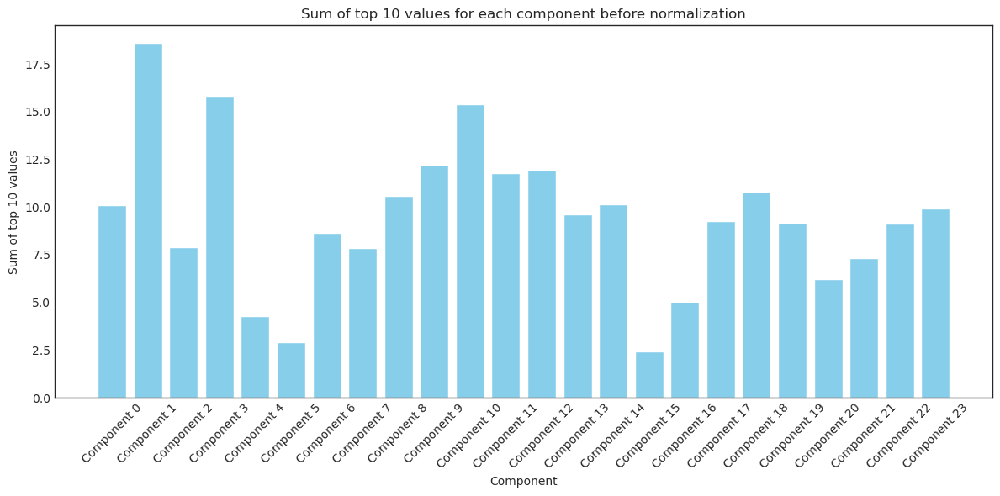

In [117]:
sum_top10_values = []

for i_component in range(n_components):
    component_values = decomp.Basis[:, i_component]
    top_values = np.sort(component_values)[-10:]
    sum_top10 = np.sum(top_values)
    sum_top10_values.append(sum_top10)

# Plotting
plt.figure(figsize=(12, 6))
plt.bar(np.arange(n_components), sum_top10_values, color='skyblue')
plt.xlabel('Component')
plt.ylabel('Sum of top 10 values')
plt.title('Sum of top 10 values for each component before normalization')
plt.xticks(np.arange(n_components), [f'Component {i}' for i in range(n_components)], rotation=45)
plt.tight_layout()
plt.savefig(dir_path_figures+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.sum_top10.before_normalization.png', bbox_inches='tight')
plt.show()

In [15]:
a = 400
b = 400
id(a) == id(b)

False